## Olist consumer segmentation

This dataset was generously provided by Olist, the largest department store in Brazilian marketplaces. Olist connects small businesses from all over Brazil to channels without hassle and with a single contract. Those merchants are able to sell their products through the Olist Store and ship them directly to the customers using Olist logistics partners.

<img src="https://i.imgur.com/HRhd2Y0.png" style="height:600px">



### Importing libraries

In [244]:
# data 
import numpy as np
import pandas as pd 
from math import pi

#plot
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

#missing value iterative imputation treatment
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

#scaler
from sklearn.preprocessing import MinMaxScaler

#metrics
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

#cluster
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.cluster import Birch

### Load csv

In [57]:

df_customer = pd.read_csv('olist_customers_dataset.csv')
df_geolocation = pd.read_csv('olist_geolocation_dataset.csv')
df_orders = pd.read_csv('olist_orders_dataset.csv')
df_order_items = pd.read_csv('olist_order_items_dataset.csv')
df_order_payments = pd.read_csv('olist_order_payments_dataset.csv')
df_order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
df_products = pd.read_csv('olist_products_dataset.csv')
df_sellers = pd.read_csv('olist_sellers_dataset.csv')

### EDA 

#### Customer data

In [58]:
df_customer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


4119 unique cities in the database.

Top 20 cities are 42.2 percent of all the orders.


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\3627493187.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cities_top.head(20).values, y=cities_top.head(20).index, palette=colours)
C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\3627493187.py:12: UserWarning: 
The palette list has fewer values (4) than needed (20) and will cycle, which may produce an uninterpretable plot.
  sns.barplot(x=cities_top.head(20).values, y=cities_top.head(20).index, palette=colours)


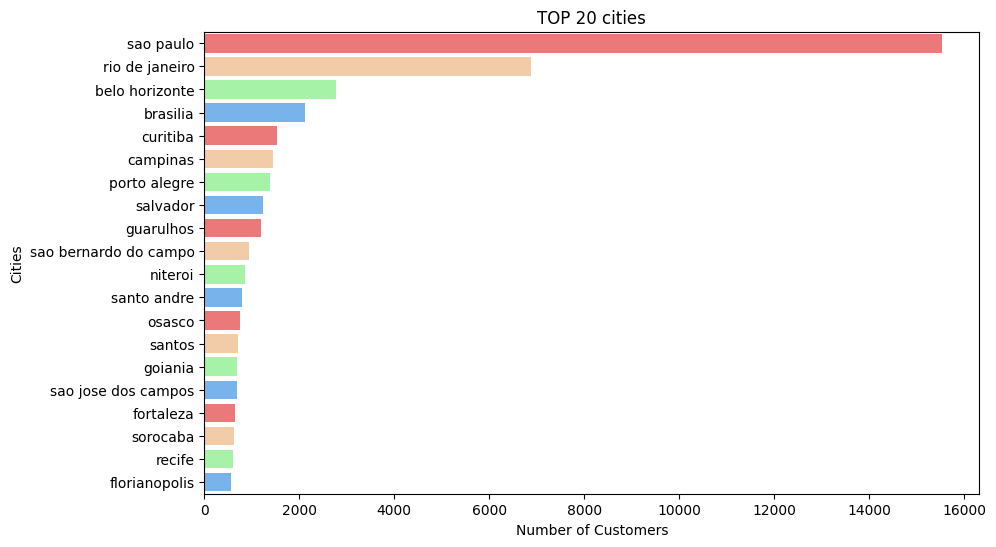

In [59]:
colours = ['#ff6666', '#ffcc99', '#99ff99', '#66b3ff']

# Finding frequent cities
cities = df_customer["customer_city"].nunique()
cities_top = df_customer.groupby('customer_city')['customer_id'].nunique().sort_values(ascending=False)

print(cities, "unique cities in the database.")
print("\nTop 20 cities are", round(cities_top.head(20).sum() / df_customer.shape[0] * 100, 1),
      "percent of all the orders.")

plt.figure(figsize=(10, 6))
sns.barplot(x=cities_top.head(20).values, y=cities_top.head(20).index, palette=colours)
plt.xlabel("Number of Customers")
plt.ylabel("Cities")
plt.title("TOP 20 cities")
plt.show()


#### Geolocation

In [60]:
df_geolocation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


#### Orders

In [61]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [62]:
date_columns = ["order_purchase_timestamp", "order_delivered_carrier_date", 
                 "order_delivered_customer_date", "order_estimated_delivery_date"]

orders_fmt = df_orders.copy()
orders_fmt[date_columns] = df_orders[date_columns].apply(
    lambda col: pd.to_datetime(col, format='%Y-%m-%d %H:%M:%S')
)


##### Checking order status with respect to number of customer

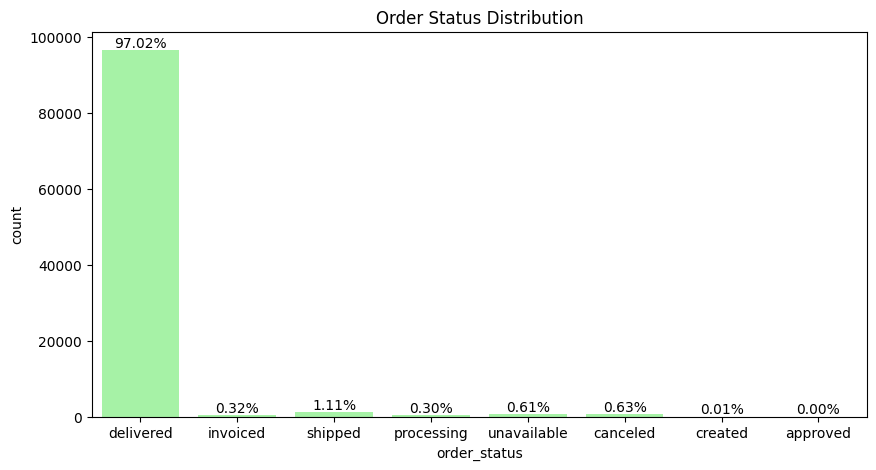

In [63]:
# Bar graph with annotations
plt.figure(figsize=(10, 5))
plots = sns.countplot(x="order_status", data=df_orders, color=colours[2])

for bar in plots.patches:
    percentage = (bar.get_height() / len(df_orders['order_status']) * 100)
    plots.annotate(f'{percentage:.2f}%',
                   (bar.get_x() + bar.get_width() / 2, bar.get_height()),
                   ha='center', va='center',
                   size=10, xytext=(0, 5),
                   textcoords='offset points')

plt.title("Order Status Distribution")
plt.show()

Most products are delivered but still there are 3% which were under processed, cancelled, unavailable. They were not delivered.

##### Time of purchase 

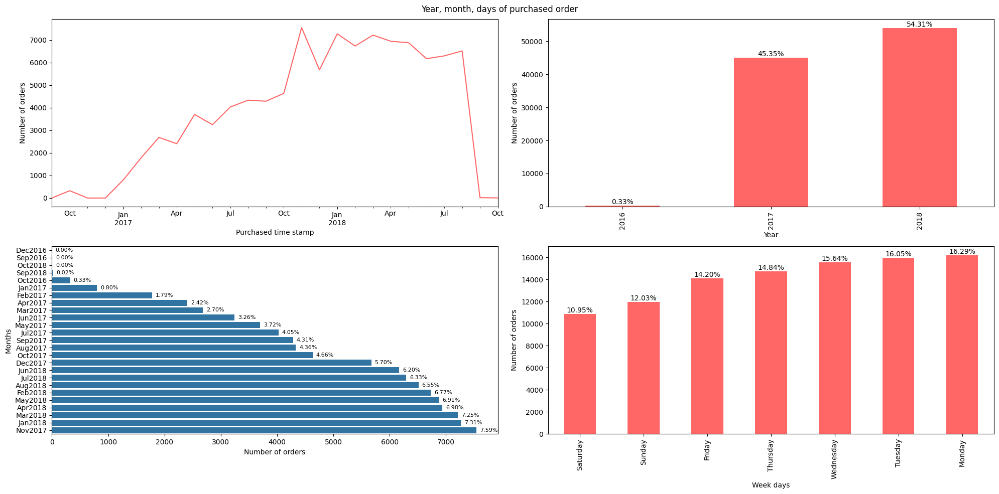

In [64]:
fig, ax = plt.subplots(2, 2, figsize=(20, 10), tight_layout=True)
fig.suptitle("Year, month, days of purchased order")

# Line chart for all over purchase timestamp
counts = orders_fmt.set_index("order_purchase_timestamp").groupby(pd.Grouper(freq='M')).count()
counts.plot(y="order_id", color=colours[0], legend=False, ax=ax[0, 0])
ax[0, 0].set_xlabel("Purchased time stamp")
ax[0, 0].set_ylabel("Number of orders")

# Order purchased through years
orders_fmt['Year'] = orders_fmt['order_purchase_timestamp'].dt.year
barPlot = orders_fmt.groupby('Year').size().plot(kind='bar', ax=ax[0, 1], color='#ff6666')
ax[0, 1].set_ylabel("Number of orders")
ax[0, 1].set_xlabel("Year")
for bar in barPlot.patches:
    barPlot.annotate(format(((bar.get_height() / len(orders_fmt['Year']) * 100)), '.2f') + "%",
                     (bar.get_x() + bar.get_width() / 2,
                      bar.get_height()), ha='center', va='center',
                     size=10, xytext=(0, 5),
                     textcoords='offset points')

# Order purchased through weekdays
orders_fmt['weekdays'] = orders_fmt['order_purchase_timestamp'].dt.day_name()
barPlot3 = orders_fmt.groupby('weekdays').size().sort_values().plot(kind='bar', ax=ax[1, 1], color='#ff6666')
ax[1, 1].set_ylabel("Number of orders")
ax[1, 1].set_xlabel("Week days")
for bar in barPlot3.patches:
    barPlot3.annotate(format(((bar.get_height() / len(orders_fmt['weekdays']) * 100)), '.2f') + "%",
                      (bar.get_x() + bar.get_width() / 2,
                       bar.get_height()), ha='center', va='center',
                      size=10, xytext=(0, 5),
                      textcoords='offset points')

# Order purchased through months
orders_fmt['month'] = orders_fmt['order_purchase_timestamp'].dt.strftime('%b%Y')
barPlot2 = sns.barplot(y=orders_fmt.groupby('month').size().sort_values().index,
                      x=orders_fmt.groupby('month').size().sort_values().values, ax=ax[1, 0])
ax[1, 0].set_xlabel("Number of orders")
ax[1, 0].set_ylabel("Months")
for p in barPlot2.patches:
    barPlot2.annotate(format(((p.get_width() / len(orders_fmt['month']) * 100)), '.2f') + "%",
                      xy=(p.get_width(), p.get_y() + p.get_height() / 2), xytext=(5, 0),
                      textcoords='offset points', ha="left", va="center", fontsize=8)

plt.show()


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\2597349614.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="order_purchase_time_day", data=orders_fmt, palette="GnBu")


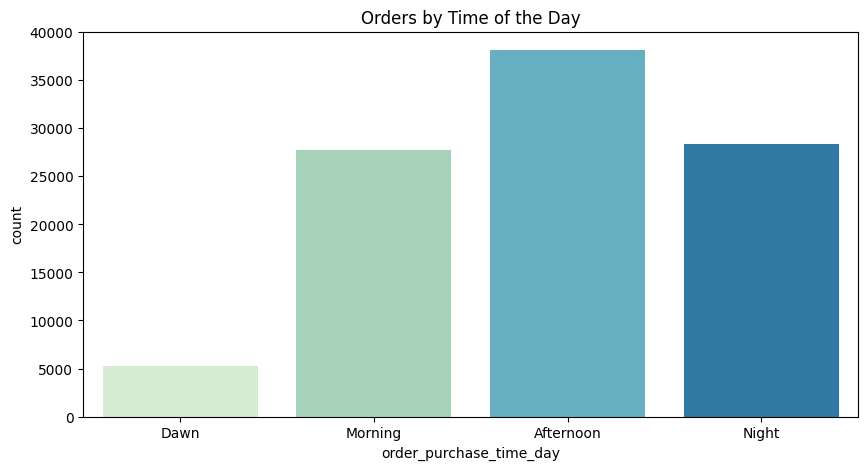

In [65]:
# Extracting the hour of the day
orders_fmt['order_purchase_hour'] = orders_fmt['order_purchase_timestamp'].dt.hour

# Defining bins and labels
hours_bins = [-0.1, 6, 12, 18, 23]
hours_labels = ['Dawn', 'Morning', 'Afternoon', 'Night']

# Creating a new column for time of the day
orders_fmt['order_purchase_time_day'] = pd.cut(orders_fmt['order_purchase_hour'], bins=hours_bins, labels=hours_labels)

# Plotting the count of orders by time of the day
plt.figure(figsize=(10, 5))
sns.countplot(x="order_purchase_time_day", data=orders_fmt, palette="GnBu")
plt.title("Orders by Time of the Day")
plt.show()

##### Checking order status with respect to number of customer

##### Days of delivery

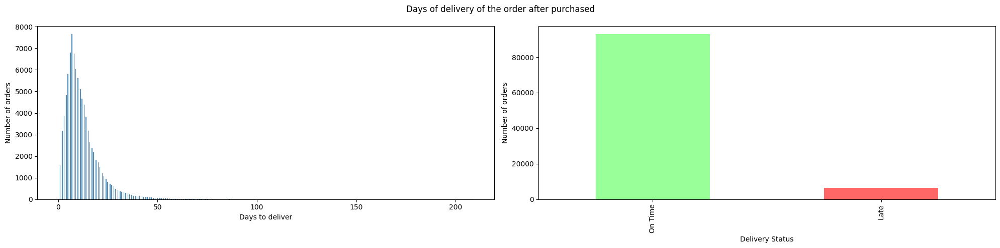

In [66]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5), tight_layout=True)
fig.suptitle('Days of delivery of the order after purchased')

# Calculate days to deliver
orders_fmt['day_to_delivery'] = (orders_fmt['order_delivered_customer_date'] - orders_fmt['order_purchase_timestamp']).dt.days

# Calculate delivery delay
orders_fmt['delivery'] = (orders_fmt['order_delivered_customer_date'] - orders_fmt['order_estimated_delivery_date']).dt.days
orders_fmt['late_delivery'] = orders_fmt['delivery'] > 0

# Plot histogram for days to deliver
sns.histplot(data=orders_fmt, x='day_to_delivery', ax=ax[0])
ax[0].set_xlabel("Days to deliver")
ax[0].set_ylabel("Number of orders")

# Plot stacked column chart for on-time and late deliveries
delivery_status_counts = orders_fmt['late_delivery'].value_counts()
delivery_status_counts.plot(kind='bar', stacked=True, ax=ax[1], color=['#99ff99', '#ff6666'])
ax[1].set_xlabel("Delivery Status")
ax[1].set_ylabel("Number of orders")
ax[1].set_xticklabels(['On Time', 'Late'])

plt.show()


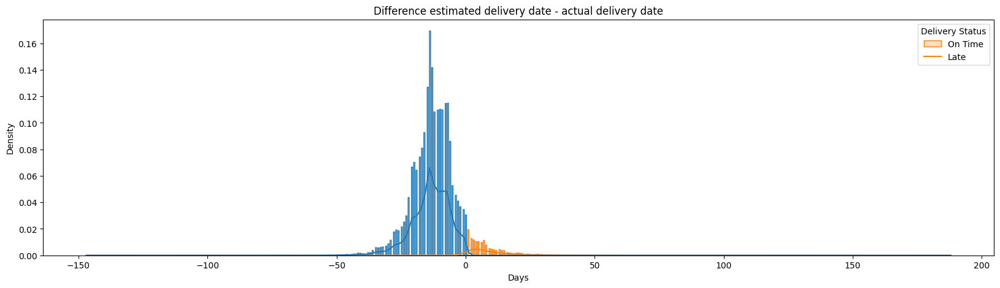

In [67]:
plt.figure(figsize=(20, 5))
sns.histplot(
    data=orders_fmt,
    x='delivery',
    kde=True,
    color=['#99ff99', '#66b3ff'],
    hue='late_delivery',
    element='step',
    stat='density',
)
plt.xlabel("Days")
plt.ylabel("Density")
plt.title("Difference estimated delivery date - actual delivery date")
plt.legend(title='Delivery Status', labels=['On Time', 'Late'])
plt.show()


#### Items on orders

In [68]:
df_order_items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


In [69]:
df_order_items.describe()

,order_item_id,price,freight_value
count,112650.000000,112650.000000,112650.000000
mean,1.197834,120.653739,19.990320
std,0.705124,183.633928,15.806405
min,1.000000,0.850000,0.000000
25%,1.000000,39.900000,13.080000
50%,1.000000,74.990000,16.260000
75%,1.000000,134.900000,21.150000
max,21.000000,6735.000000,409.680000


##### Freight value distribution

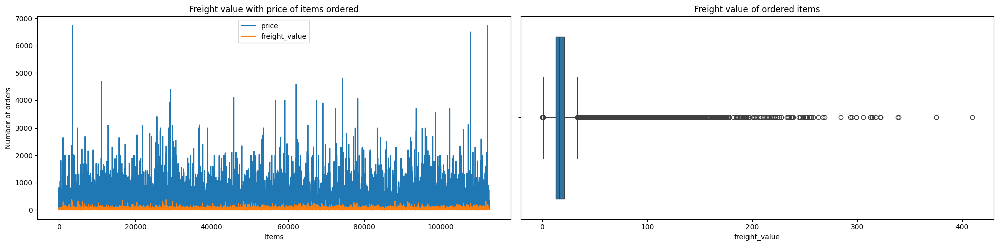

In [70]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5), tight_layout=True)

# Line plot for freight value and price
df_order_items[['price', 'freight_value']].plot(ax=ax[0])
ax[0].set_title('Freight value with price of items ordered')
ax[0].set_xlabel("Items")
ax[0].set_ylabel("Number of orders")

# Boxplot for freight value
sns.boxplot(data=df_order_items, x='freight_value', ax=ax[1])
ax[1].set_title("Freight value of ordered items")

plt.show()


#### Payments

In [71]:
df_order_payments.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


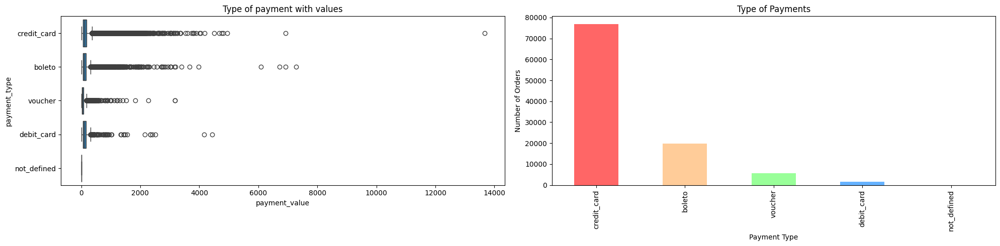

In [72]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5), tight_layout=True)

# Boxplot for type of payment with values
sns.boxplot(data=df_order_payments, x="payment_value", y="payment_type", ax=ax[0])
ax[0].set_title("Type of payment with values")

# Bar chart for type of payments
payment_counts = df_order_payments['payment_type'].value_counts()
payment_counts.plot(kind='bar', ax=ax[1], color=['#ff6666', '#ffcc99', '#99ff99', '#66b3ff'])
ax[1].set_title('Type of Payments')
ax[1].set_xlabel('Payment Type')
ax[1].set_ylabel('Number of Orders')

plt.show()


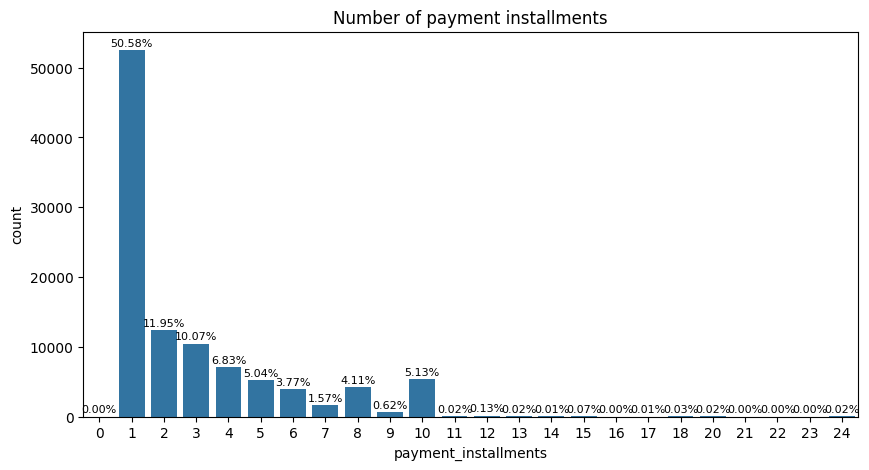

In [73]:
plt.figure(figsize=(10, 5))
plot = sns.countplot(data=df_order_payments, x="payment_installments")

# Adding percentage annotations
total_records = len(df_order_payments['payment_installments'])
for bar in plot.patches:
    percentage = (bar.get_height() / total_records) * 100
    plot.annotate(f'{percentage:.2f}%',
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=8, xytext=(0, 5),
                   textcoords='offset points')

plt.title("Number of payment installments")
plt.show()


#### Reviews

In [74]:
df_order_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


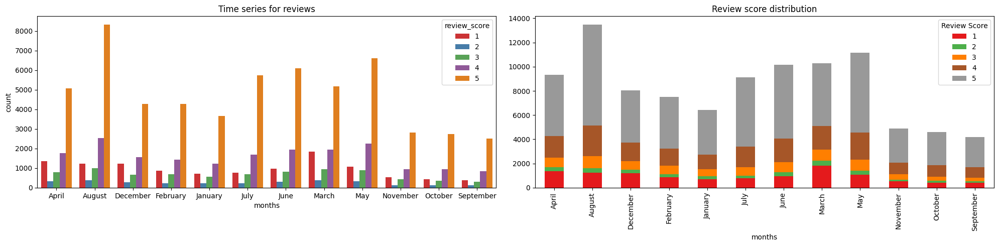

In [75]:
datacheck = df_order_reviews.copy()
datacheck['review_creation_date'] = pd.to_datetime(df_order_reviews['review_creation_date'], format='%Y-%m-%d %H:%M:%S')
datacheck["months"] = datacheck['review_creation_date'].dt.month_name()

fig, ax = plt.subplots(1, 2, figsize=(20, 5), tight_layout=True)

# Using a bar chart for time series
sns.barplot(data=datacheck.groupby(['months', 'review_score']).size().reset_index(name='count'),
            x='months', y='count', hue='review_score', palette='Set1', ax=ax[0])
ax[0].set_title("Time series for reviews")

# Using a stacked bar chart for review score distribution
datacheck.groupby(['months', 'review_score']).size().unstack().plot(kind='bar', stacked=True, colormap='Set1', ax=ax[1])
ax[1].set_title('Review score distribution')
ax[1].legend(title='Review Score', bbox_to_anchor=(1, 1))

plt.show()


#### Products

In [76]:
df_products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\1671208541.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90)
C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\1671208541.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90)


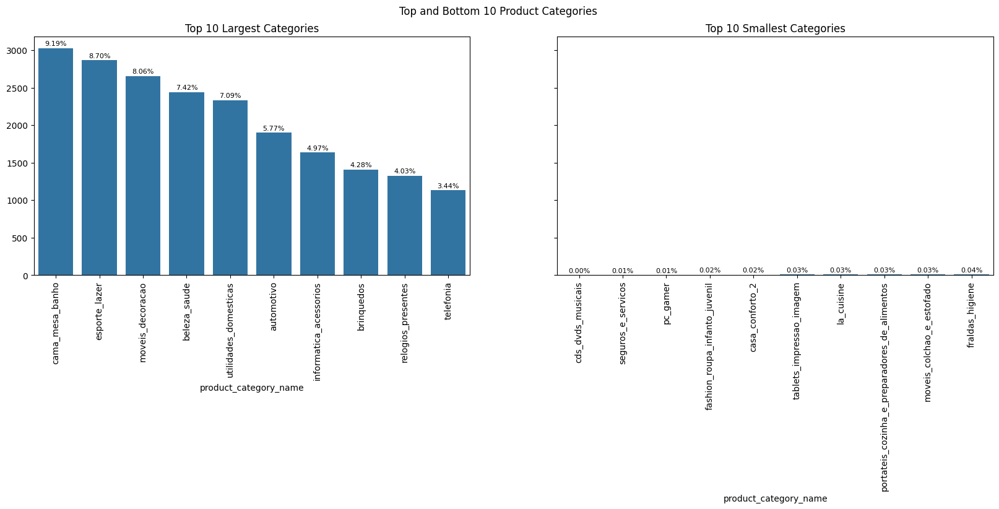

In [77]:
# Top 10 largest categories
top_10_largest = df_products["product_category_name"].value_counts().nlargest(10)

fig, axes = plt.subplots(1, 2, figsize=(20, 5), sharey=True)
fig.suptitle('Top and Bottom 10 Product Categories')

# Plotting the top 10 largest categories
plot_top = sns.barplot(x=top_10_largest.index, y=top_10_largest.values, ax=axes[0])
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90)
axes[0].set_title('Top 10 Largest Categories')

# Adding percentage annotations on top of the bars
total_products = len(df_products["product_category_name"])
for bar in plot_top.patches:
    percentage = (bar.get_height() / total_products) * 100
    axes[0].annotate(f'{percentage:.2f}%', 
                    (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
                    ha='center', va='center', size=8, xytext=(0, 5),
                    textcoords='offset points')

# Top 10 smallest categories
top_10_smallest = df_products["product_category_name"].value_counts().nsmallest(10)

# Plotting the top 10 smallest categories
plot_bottom = sns.barplot(x=top_10_smallest.index, y=top_10_smallest.values, ax=axes[1])
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90)
axes[1].set_title('Top 10 Smallest Categories')

# Adding percentage annotations on top of the bars
for bar in plot_bottom.patches:
    percentage = (bar.get_height() / total_products) * 100
    axes[1].annotate(f'{percentage:.2f}%', 
                    (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
                    ha='center', va='center', size=8, xytext=(0, 5),
                    textcoords='offset points')

plt.show()


#### Sellers

In [78]:
df_sellers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


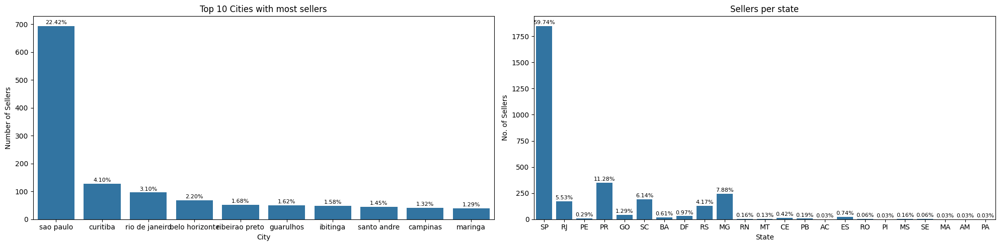

In [79]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5), tight_layout=True)

# Top 10 city-wise sellers
sellercity = df_sellers["seller_city"].value_counts().nlargest(10)

plot1 = sns.barplot(x=sellercity.index, y=sellercity.values, ax=ax[0])
for bar in plot1.patches:
    percentage = (bar.get_height() / len(df_sellers["seller_city"])) * 100
    ax[0].annotate(f'{percentage:.2f}%',
                   (bar.get_x() + bar.get_width() / 2, bar.get_height()),
                   ha='center', va='center', size=8, xytext=(0, 5),
                   textcoords='offset points')
ax[0].set_title('Top 10 Cities with most sellers')
ax[0].set_xlabel('City')
ax[0].set_ylabel('Number of Sellers')

# State-wise sellers
plot2 = sns.countplot(x='seller_state', data=df_sellers, ax=ax[1])
for bar in plot2.patches:
    percentage = (bar.get_height() / len(df_sellers["seller_city"])) * 100
    ax[1].annotate(f'{percentage:.2f}%',
                   (bar.get_x() + bar.get_width() / 2, bar.get_height()),
                   ha='center', va='center', size=8, xytext=(0, 5),
                   textcoords='offset points')
ax[1].set_title('Sellers per state')
ax[1].set_xlabel('State')
ax[1].set_ylabel('No. of Sellers')

plt.show()


### Merging All Dataframes

In [80]:
# Merging DataFrames
data_train = df_orders.merge(df_customer, on="customer_id") \
                      .merge(df_order_items, on="order_id") \
                      .merge(df_products, on="product_id") \
                      .merge(df_order_payments, on="order_id") \
                      .merge(df_sellers, on="seller_id") \
                      .merge(df_order_reviews, on="order_id")

# Creating a new DataFrame for geolocation
geol = df_geolocation.groupby(['geolocation_zip_code_prefix'], as_index=False).agg({
    'geolocation_lat': 'mean',
    'geolocation_lng': 'mean'
})

# Merging geolocation data with the main DataFrame
data_train = data_train.merge(geol, how='left', left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix')

# Dropping duplicate columns created during the merge
data_train = data_train.drop(columns=['geolocation_zip_code_prefix'])

# Displaying the shape of the resulting DataFrame
data_train.shape


(117329, 41)

In [81]:
data_train.describe().round(2)

,customer_zip_code_prefix,order_item_id,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,payment_sequential,payment_installments,payment_value,seller_zip_code_prefix,review_score,geolocation_lat,geolocation_lng
count,117329.00,117329.00,117329.00,117329.00,115634.00,115634.00,115634.00,117309.00,117309.00,117309.00,117309.00,117329.00,117329.00,117329.00,117329.00,117329.00,117013.00,117013.00
mean,35060.12,1.19,120.52,20.03,48.77,785.80,2.21,2110.76,30.25,16.61,23.07,1.09,2.94,172.06,24450.78,4.03,-21.24,-46.20
std,29849.50,0.68,182.94,15.83,10.03,652.38,1.72,3785.13,16.18,13.45,11.75,0.73,2.78,265.39,27582.36,1.39,5.56,4.04
min,1003.00,1.00,0.85,0.00,5.00,4.00,1.00,0.00,7.00,2.00,6.00,1.00,0.00,0.00,1001.00,1.00,-33.69,-72.67
25%,11250.00,1.00,39.90,13.08,42.00,346.00,1.00,300.00,18.00,8.00,15.00,1.00,1.00,60.75,6429.00,4.00,-23.59,-48.11
50%,24240.00,1.00,74.90,16.28,52.00,600.00,1.00,700.00,25.00,13.00,20.00,1.00,2.00,108.10,13660.00,5.00,-22.93,-46.63
75%,58770.00,1.00,134.90,21.18,57.00,983.00,3.00,1800.00,38.00,20.00,30.00,1.00,4.00,189.06,28035.00,5.00,-20.18,-43.63
max,99990.00,21.00,6735.00,409.68,76.00,3992.00,20.00,40425.00,105.00,105.00,118.00,29.00,24.00,13664.08,99730.00,5.00,42.18,-8.72


## Data cleaning
1. Handling missing values.
2. Handling duplicate values.
3. Handling the time format.

#### Missing value

In [82]:
def missing_values(df):
    # Total missing values
    mis_val = df.isnull().sum()
    
    # Percentage of missing values
    mis_val_percent = 100 * mis_val / len(df)
    
    # Create a DataFrame with the results
    mis_val_table = pd.DataFrame({'Missing Values': mis_val, '% of Total Values': mis_val_percent})
    
    # Filter columns with missing values
    mis_val_table = mis_val_table[mis_val_table['% of Total Values'] != 0].sort_values('% of Total Values', ascending=False).round(1)
    
    # Print summary information
    print(f"The dataframe has {df.shape[1]} columns.\nThere are {mis_val_table.shape[0]} columns that have missing values.")
    
    return mis_val_table


In [83]:
missing_values(data_train)

The dataframe has 41 columns.
There are 15 columns that have missing values.


,Missing Values,% of Total Values
review_comment_title,103437,88.2
review_comment_message,67650,57.7
order_delivered_customer_date,2471,2.1
product_category_name,1695,1.4
product_name_lenght,1695,1.4
product_description_lenght,1695,1.4
product_photos_qty,1695,1.4
order_delivered_carrier_date,1235,1.1
geolocation_lat,316,0.3
geolocation_lng,316,0.3


<Axes: >

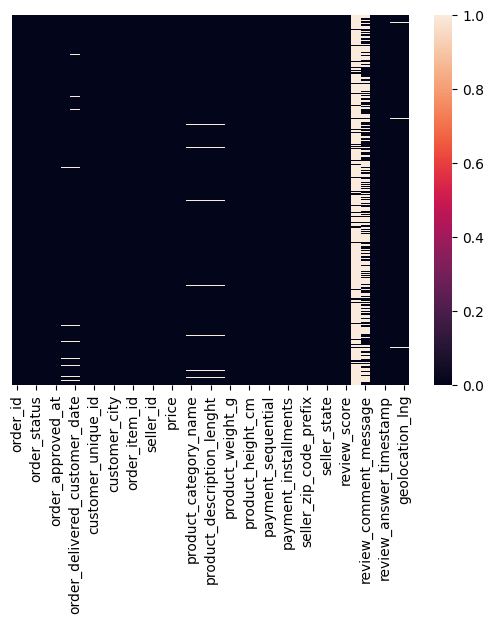

In [84]:
sns.heatmap(data_train.isnull(), yticklabels=False)

In [85]:
data_missing_columns = data_train.columns.drop(['review_comment_title', "review_comment_message", 'order_id', 'customer_id', 'product_id','customer_unique_id', 'order_item_id', 'seller_id', 'review_id'])

# Select numerical columns
numerical_col_train = data_train[data_missing_columns].select_dtypes(include=[np.number]).columns

# Numerical missing value imputation
imputer_numerical = IterativeImputer(max_iter=25, random_state=0)
data_train[numerical_col_train] = imputer_numerical.fit_transform(data_train[numerical_col_train])

# Select categorical variables
categorical_col_train = data_train[data_missing_columns].select_dtypes(exclude=[np.number]).columns

# Categorical missing value imputation
imputer_categorical = SimpleImputer(missing_values=np.NaN, strategy='most_frequent')
data_train[categorical_col_train] = imputer_categorical.fit_transform(data_train[categorical_col_train])

If customer didn't insert a title, then replaces as "Missing"

In [86]:
# Initialize SimpleImputer for review comments with empty string constant filling
imputer_simple_review = SimpleImputer(strategy='constant', fill_value='')

# Impute missing values for review comments
columns_to_impute = ['review_comment_title', 'review_comment_message']
data_train[columns_to_impute] = imputer_simple_review.fit_transform(data_train[columns_to_impute])

In [87]:
missing_values(data_train)


The dataframe has 41 columns.
There are 0 columns that have missing values.


,Missing Values,% of Total Values


<Axes: >

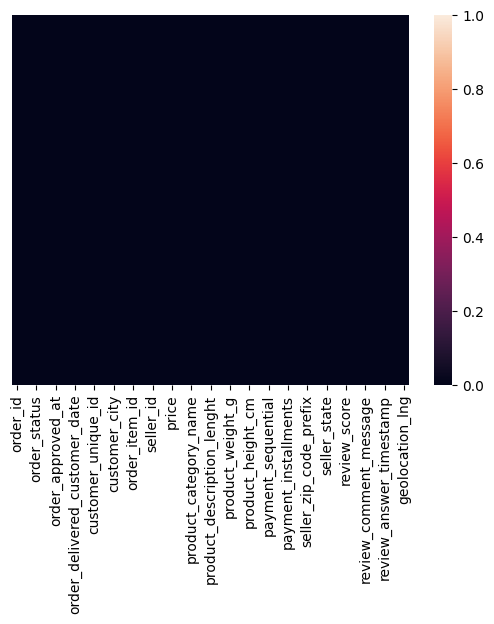

In [88]:
sns.heatmap(data_train.isnull(), yticklabels=False, vmax=1, vmin=0)

#### Duplicate values

In [89]:
print("Duplicate rows:" , data_train.duplicated().sum())

Duplicate rows: 0


#### Time Format

In [90]:
# List of time-related columns
time_cols = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date',
             'order_delivered_customer_date', 'order_estimated_delivery_date', 'shipping_limit_date',
             'review_creation_date', 'review_answer_timestamp']

# Convert date objects to pandas datetime format
data_train[time_cols] = data_train[time_cols].apply(pd.to_datetime, format='%Y-%m-%d %H:%M:%S')

#### Treating outliers

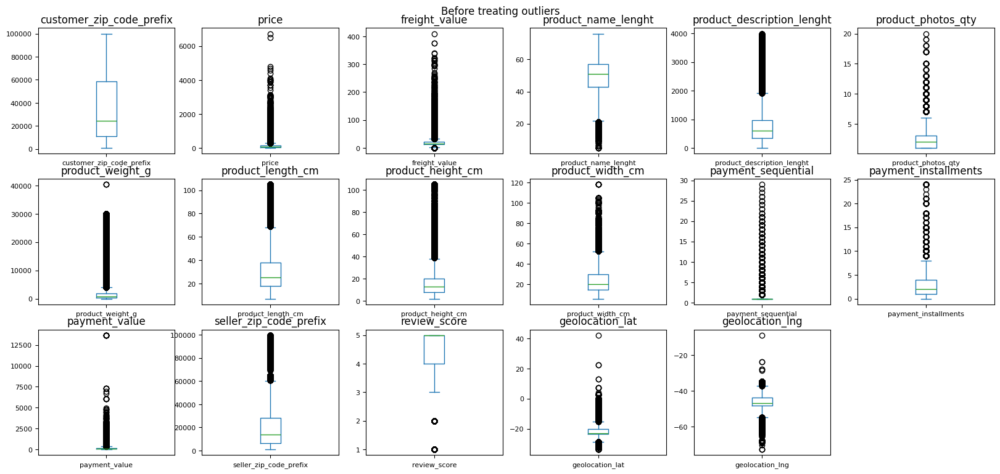

In [91]:
# Selecting only float64 columns
float_cols = data_train.select_dtypes(include=["float64"])

# Calculating the number of rows and columns for subplots
num_cols = len(float_cols.columns)
num_rows = int(np.ceil(num_cols / 6))

# Plotting box plots for each float64 column
fig, axes = plt.subplots(nrows=num_rows, ncols=6, figsize=(20, num_rows * 3))
axes = axes.flatten()  # Flatten the 2D array of axes

# Iterate through the float64 columns and plot box plots
for i, (col, ax) in enumerate(zip(float_cols.columns, axes)):
    float_cols[col].plot(kind='box', ax=ax, fontsize=8)
    ax.set_title(col)

# Hide empty subplots
for i in range(num_cols, len(axes)):
    axes[i].axis('off')

# Setting plot title
plt.suptitle('Before treating outliers', y=0.92)

# Display the plots
plt.show()


Replacing outliers

In [92]:
# Function to clip outliers in a DataFrame column
def clip_outliers(column):
    q1, q3 = column.quantile([0.025, 0.975])
    return np.where(column > q3, q3, column)

# Clip outliers for all float64 columns in the DataFrame
float_cols = data_train.select_dtypes(include=["float64"])
data_train[float_cols.columns] = float_cols.apply(clip_outliers)

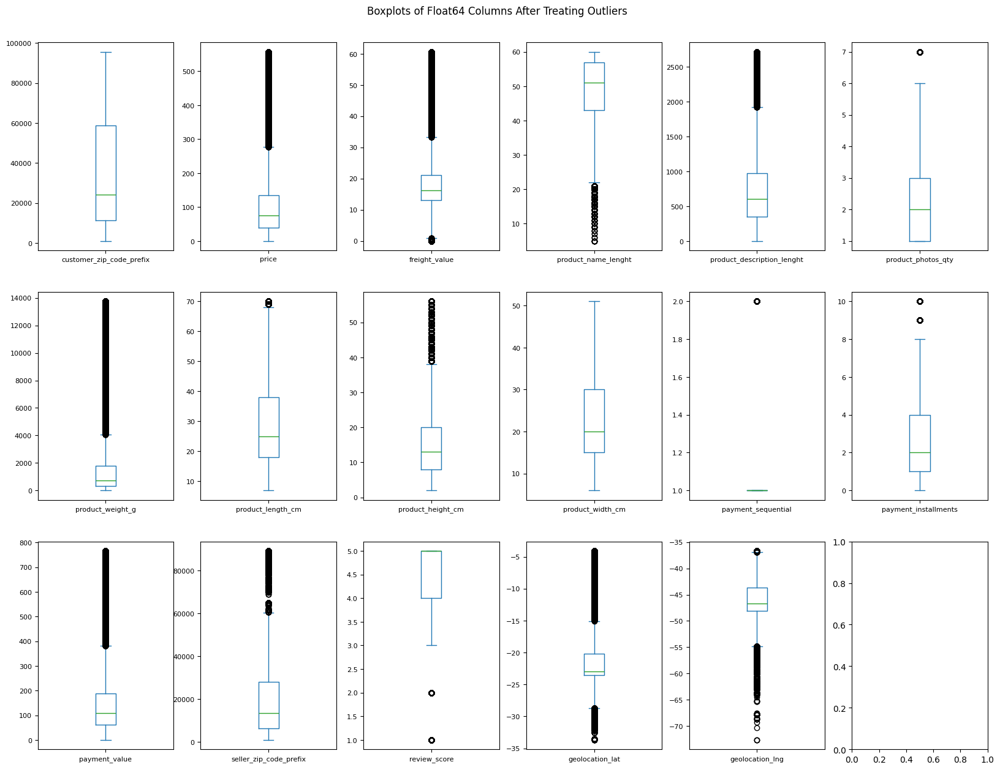

In [93]:
# Selecting columns with float64 data types
float_columns = data_train.select_dtypes(include=["float64"])

# Calculate the number of rows and columns for subplots
num_cols = float_columns.shape[1]
num_rows = (num_cols - 1) // 6 + 1  # Adjust the number of rows based on the number of columns

# Plotting boxplots for each selected column
fig, axes = plt.subplots(nrows=num_rows, ncols=6, figsize=(20, num_rows * 5))

# Iterate over the columns and plot on corresponding axes
for i, col in enumerate(float_columns.columns):
    row_idx, col_idx = divmod(i, 6)
    float_columns[col].plot(kind='box', ax=axes[row_idx, col_idx], fontsize=8)
    
# Setting title for the plot
plt.suptitle('Boxplots of Float64 Columns After Treating Outliers', y=0.92)

# Displaying the plot
plt.show()

## Feature engineering

#### New features

Delivery Days: This feature represents the duration it took to deliver a product, calculated as the difference between the item purchase date and the date of delivery.

Late Delivery: This binary feature indicates whether the delivered item was late or not. It is determined by comparing the estimated delivery date with the actual date of delivery.

Order Freight Ratio: This feature calculates the ratio of the freight value (transportation cost) to the product value in an order.

Total Order Value: Combining the product value and the freight value, this feature represents the total monetary value of an order.

Day of Order: This categorical feature reveals the day of the week on which the order was placed.

Approval Time (mins): This feature measures the time taken by Olist’s system to approve an order after it has been placed but before it's communicated to the supplier or carrier, expressed in minutes.

Customer Orders: Indicates the number of unique orders each customer has made.

Date of Purchase: Represents the specific date on which a customer purchased the item.

Time of Purchase: Captures the time of day when customers make their purchases.

Length of Comments: This feature calculates the number of characters in the comments provided by customers in their reviews.

Number of Comments: Represents the count of comments posted by individual customers.

In [94]:
# Calculate delivery days
data_train['delivery_days'] = (data_train['order_estimated_delivery_date'] - data_train['order_delivered_customer_date']).dt.days

# Identify late deliveries
data_train['late_delivery'] = np.where(data_train['delivery_days'] >= 0, 0, 1)

# Calculate freight ratio
data_train['freight_ratio'] = data_train['freight_value'] / data_train['payment_value']

# Calculate total order value
data_train['total_order_value'] = data_train['payment_value'] + data_train['freight_value']

# Extract weekday from purchase timestamp
data_train['order_weekday'] = data_train['order_purchase_timestamp'].dt.weekday

# Calculate approval time in minutes
data_train['approval_time_min'] = (data_train['order_approved_at'] - data_train['order_purchase_timestamp']).dt.total_seconds() / 60

# Calculate length of review comments
data_train['length_reviews_comment'] = data_train['review_comment_message'].str.len()

# Count comments and number of reviews per customer
data_train['count_comment'] = data_train['review_comment_message'].str.len().gt(0).astype(int)
data_train['number_reviews'] = data_train.groupby('customer_unique_id')['count_comment'].transform('nunique')

# Drop the temporary count_comment column
data_train.drop('count_comment', axis=1, inplace=True)

# Bin purchase hours into categories
hours_bins = [-0.1, 6, 12, 18, 23]
hours_labels = ['Dawn', 'Morning', 'Afternoon', 'Night']
data_train['purchase_time_day'] = pd.cut(data_train['order_purchase_timestamp'].dt.hour, bins=hours_bins, labels=hours_labels)

In [95]:
# Columns to drop
columns_to_drop = ['order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date']

# Drop specified columns
data_train.drop(columns=columns_to_drop, inplace=True)

##### Encoding the 3 categorical attributes: order_status, and payment_type.

In [96]:
# Categorical attributes for one-hot encoding
cat_attributes = ['order_status', 'payment_type', 'purchase_time_day']

# One-hot encode categorical attributes
data_train = pd.get_dummies(data_train, columns=cat_attributes)

In [97]:
data_train.shape

(117329, 58)

## RFM Analysis

RFM (Recency, Frequency, Monetary) analysis is a marketing model employed for segmenting a company's consumer base based on their purchasing patterns and behaviors.

* Recency: This metric assesses how recently a customer has engaged in a transaction, providing insights into their recent activity. Customers with more recent transactions are often considered more engaged and responsive.

* Frequency: This metric measures the frequency of a customer's ordering or buying behavior, highlighting how often they interact with the company. Higher frequency often indicates a more loyal and engaged customer.

* Monetary: This metric evaluates the monetary value associated with a customer, indicating the amount they spend on purchasing products and contributing to the company's revenue. Customers with higher monetary values are typically more profitable and may warrant special attention in marketing strategies.

In [116]:
# Recency 
data_rfm = data_train.groupby(by='customer_unique_id',
                              as_index=False)['order_purchase_timestamp'].max()

recent_date = data_train['order_purchase_timestamp'].dt.date.max()
data_rfm['Recency'] = data_rfm['order_purchase_timestamp'].dt.date.apply(lambda x: (recent_date - x).days)

# Frequency
data_rfm['Frequency'] = data_train.groupby('customer_unique_id')['order_id'].transform('nunique')

# Monetary 
data_rfm['Monetary'] = data_train.groupby('customer_unique_id', 
                                          as_index=False)['payment_value'].sum()['payment_value']

data_rfm

,customer_unique_id,order_purchase_timestamp,Recency,Frequency,Monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,116,2,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,119,2,27.19
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,542,2,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,326,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,293,1,196.89
...,...,...,...,...,...
94715,fffcf5a5ff07b0908bd4e2dbc735a684,2017-06-08 21:00:36,452,1,1531.82
94716,fffea47cd6d3cc0a88bd621562a9d061,2017-12-10 20:07:56,267,1,84.58
94717,ffff371b4d645b6ecea244b27531430a,2017-02-07 15:49:16,573,1,112.46
94718,ffff5962728ec6157033ef9805bacc48,2018-05-02 15:17:41,124,1,133.69


In [117]:
data_rfm.describe().T

,count,mean,min,25%,50%,75%,max,std
order_purchase_timestamp,94720,2018-01-03 07:09:09.244467968,2016-09-04 21:15:19,2017-09-15 23:22:18.500000,2018-01-22 17:09:20.500000,2018-05-07 12:49:25,2018-09-03 09:06:57,NaN
Recency,94720.0,243.338967,0.0,119.0,224.0,353.0,729.0,153.164273
Frequency,94720.0,1.08978,1.0,1.0,1.0,1.0,16.0,0.394197
Monetary,94720.0,195.838988,9.59,63.9,113.15,202.965,18381.84,334.857769


Verifing distribution of recency, frequency and Monetry

C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\4081124447.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data_rfm['Recency'], bins=8, kde=False, rug=True, ax=axes[0])
C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\4081124447.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data_rfm

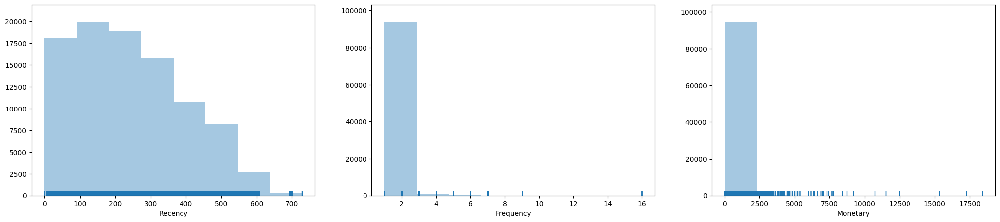

In [118]:
fig, axes = plt.subplots(1, 3, figsize=(25, 5))

sns.distplot(data_rfm['Recency'], bins=8, kde=False, rug=True, ax=axes[0])
sns.distplot(data_rfm['Frequency'], bins=8, kde=False, rug=True, ax=axes[1])
sns.distplot(data_rfm['Monetary'], bins=8, kde=False, rug=True, ax=axes[2])

plt.show()

* **Recency** - More customers last 350 days
* **Frequency** - Low orders per customer
* **Monetary** - 75% of the orders are below 203 BRL, and the mean is close to 196. High density of orders caps at about 3500 BRL

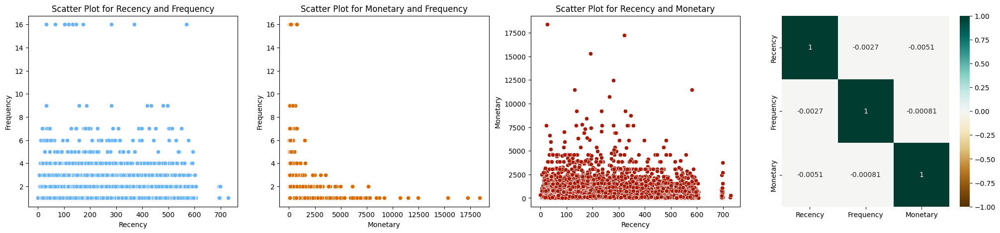

In [119]:
fig, axes = plt.subplots(1, 4, figsize=(25, 5))

# Scatter Plot for Recency and Frequency
sns.scatterplot(x=data_rfm['Recency'], y=data_rfm['Frequency'], color="#66b3ff", ax=axes[0])
axes[0].set_title('Scatter Plot for Recency and Frequency')
axes[0].set_xlabel('Recency')
axes[0].set_ylabel('Frequency')

# Scatter Plot for Monetary and Frequency
sns.scatterplot(x=data_rfm['Monetary'], y=data_rfm['Frequency'], color="#DA6A00", ax=axes[1])
axes[1].set_title('Scatter Plot for Monetary and Frequency')
axes[1].set_xlabel('Monetary')
axes[1].set_ylabel('Frequency')

# Scatter Plot for Recency and Monetary
sns.scatterplot(x=data_rfm['Recency'], y=data_rfm['Monetary'], color="#AA1803", ax=axes[2])
axes[2].set_title('Scatter Plot for Recency and Monetary')
axes[2].set_xlabel('Recency')
axes[2].set_ylabel('Monetary')

# Heatmap for correlation matrix
sns.heatmap(data_rfm[['Recency', 'Frequency', 'Monetary']].corr(), vmin=-1, vmax=1, annot=True, cmap="BrBG", ax=axes[3])

plt.show()

No strong corr.

##### Ranking customer on the basis of RFM scores

In [120]:
# Define the bin edges for quartiles
recency_bins = pd.qcut(data_rfm['Recency'], 5, labels=[5, 4, 3, 2, 1])
frequency_bins = pd.qcut(data_rfm['Frequency'].rank(method="first"), 5, labels=[1, 2, 3, 4, 5])
monetary_bins = pd.qcut(data_rfm['Monetary'], 5, labels=[1, 2, 3, 4, 5])

# Create new columns for quartile scores
data_rfm["recency_score"] = recency_bins
data_rfm["frequency_score"] = frequency_bins
data_rfm["monetary_score"] = monetary_bins

# Create a combined score column
data_rfm['score_rfm'] = data_rfm['recency_score'].astype(str) + data_rfm['frequency_score'].astype(str) + data_rfm['monetary_score'].astype(str)

data_rfm.head()

,customer_unique_id,order_purchase_timestamp,Recency,Frequency,Monetary,recency_score,frequency_score,monetary_score,score_rfm
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,116,2,141.90,4,5,4,454
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,119,2,27.19,4,5,1,451
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,542,2,86.22,1,5,2,152
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,326,1,43.62,2,1,1,211
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,293,1,196.89,2,1,4,214


### RFM Segmentation

RFM segmentation is a marketing analysis technique that classifies customers based on three key metrics: Recency, Frequency, and Monetary Value. These metrics provide insights into customer behavior and help businesses tailor their marketing strategies to different customer segments.

*reference:* [Conectiff](https://connectif.ai/en/blog/what-are-rfm-scores-and-how-to-calculate-them/#:~:text=RFM%20is%20a%20marketing%20technique,targets%20and%20increase%20conversion%20rates.)

In [121]:
seg_map= {
    r'111|112|121|131|141|151': 'Lost customers',
    r'332|322|233|232|223|222|132|123|122|212|211': 'Hibernating customers', 
    r'155|154|144|214|215|115|114|113': 'Cannot Lose Them',
    r'255|254|245|244|253|252|243|242|235|234|225|224|153|152|145|143|142|135|134|133|125|124': 'At Risk',
    r'331|321|312|221|213|231|241|251': 'About To Sleep',
    r'535|534|443|434|343|334|325|324': 'Need Attention',
    r'525|524|523|522|521|515|514|513|425|424|413|414|415|315|314|313': 'Promising',
    r'512|511|422|421|412|411|311': 'New Customers',
    r'553|551|552|541|542|533|532|531|452|451|442|441|431|453|433|432|423|353|352|351|342|341|333|323': 'Potential Loyalist',
    r'543|444|435|355|354|345|344|335': 'Loyal',
    r'555|554|544|545|454|455|445': 'Champions'
}

In [122]:
# Combine the RFM scores into a 'Segments' column
data_rfm['Segments'] = data_rfm[['recency_score', 'frequency_score', 'monetary_score']].astype(str).agg(''.join, axis=1)

# Replace the segment codes with meaningful labels using seg_map
data_rfm['Segments'] = data_rfm['Segments'].replace(seg_map, regex=True)

data_rfm.head()

,customer_unique_id,order_purchase_timestamp,Recency,Frequency,Monetary,recency_score,frequency_score,monetary_score,score_rfm,Segments
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,116,2,141.90,4,5,4,454,Champions
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,119,2,27.19,4,5,1,451,Potential Loyalist
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,542,2,86.22,1,5,2,152,At Risk
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,326,1,43.62,2,1,1,211,Hibernating customers
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,293,1,196.89,2,1,4,214,Cannot Lose Them


In [123]:
data_rfm.groupby('Segments', as_index=False).agg({
    'Recency':'mean',
    'Frequency':'mean',
    'Monetary': "mean"
})

,Segments,Recency,Frequency,Monetary
0,About To Sleep,283.176660,1.055037,52.740977
1,At Risk,392.555428,1.124466,271.640900
2,Cannot Lose Them,440.881890,1.098341,319.833438
3,Champions,90.020617,1.263820,411.361087
4,Hibernating customers,347.258146,1.000000,80.284560
5,Lost customers,480.792827,1.083544,45.146930
6,Loyal,182.139434,1.111980,361.555336
7,Need Attention,160.632858,1.000000,257.023972
8,New Customers,128.444444,1.000000,53.483047
9,Potential Loyalist,135.770353,1.165740,75.433454


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\1991982613.py:17: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



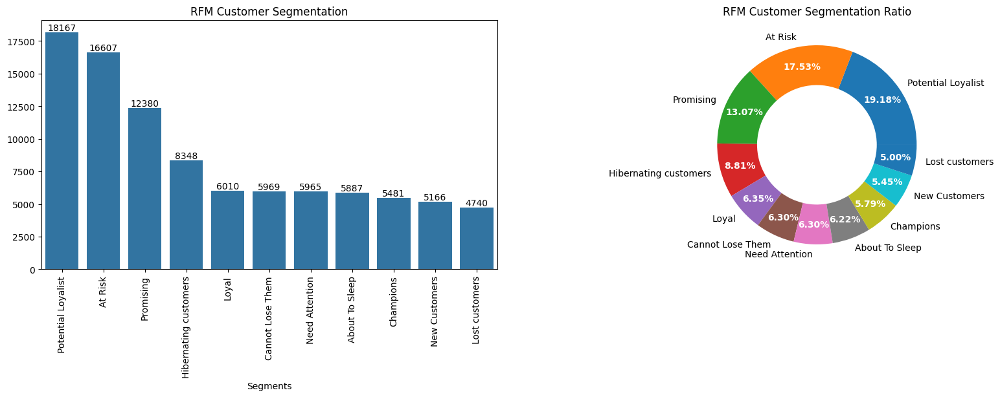

In [151]:
def annotate_bars(plot, data):
    for bar in plot.patches:
        plot.annotate(
            format(bar.get_height(), '.0f'),
            (bar.get_x() + bar.get_width() / 2, bar.get_height()),
            ha='center', va='center',
            size=10, xytext=(0, 5),
            textcoords='offset points'
        )

def plot_rfm_segmentation(data):
    fig, axes = plt.subplots(1, 2, figsize=(20, 5))

    # Bar plot
    ax1 = sns.barplot(x=data['Segments'].value_counts().index, y=data['Segments'].value_counts().values, ax=axes[0])
    annotate_bars(ax1, data)
    ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
    ax1.set_title('RFM Customer Segmentation')
    ax1.set_xlabel("Segments")

    # Donut chart
    ax2 = axes[1]
    wedges, texts, autotexts = ax2.pie(data['Segments'].value_counts(), labels=data['Segments'].value_counts().index, autopct='%.2f%%', pctdistance=0.8, wedgeprops=dict(width=0.4))
    
    # Add a circle in the center to make it a donut chart
    centre_circle = plt.Circle((0,0),0.2,fc='white')
    ax2.add_artist(centre_circle)
    for text, autotext in zip(texts, autotexts):
        text.set(size=10)
        autotext.set(size=10, color='white', weight='bold')

    ax2.set_title("RFM Customer Segmentation Ratio")

    plt.show()

plot_rfm_segmentation(data_rfm)

In [157]:
def create_3d_scatter_plot(data, x, y, z, color, width=1000, height=700):
    fig = px.scatter_3d(data, x=x, y=y, z=z, color=color, width=width, height=height)
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    return fig

fig = create_3d_scatter_plot(data_rfm, x='Recency', y='Frequency', z='Monetary', color='Segments')
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': ('Segments=Champions<br>Recency=' ... 'r>Monetary=%{z}<extra></extra>'),
              'legendgroup': 'Champions',
              'marker': {'color': '#636efa', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'Champions',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([116,  38,  44, ..., 136,  63, 145], dtype=int64),
              'y': array([2, 2, 2, ..., 1, 1, 1], dtype=int64),
              'z': array([ 141.9 ,  272.04,  170.68, ...,  200.9 , 4595.46,  710.7 ])},
             {'hovertemplate': ('Segments=Potential Loyalist<br' ... 'r>Monetary=%{z}<extra></extra>'),
              'legendgroup': 'Potential Loyalist',
              'marker': {'color': '#EF553B', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'Potential Loyalist',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([119,  73,  68, ..., 260, 267, 124], dtype=int64),
              'y': array([2, 2, 2, ..., 1, 1, 1], dtype=int64),
              'z': array([ 27.19,  63.33, 124.32, ...,  73.16,  84.58, 133.69])},
             {'hovertemplate': ('Segments=At Risk<br>Recency=%{' ... 'r>Monetary=%{z}<extra></extra>'),
              'legendgroup': 'At Risk',
              'marker': {'color': '#00cc96', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'At Risk',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([542, 394, 307, ..., 308, 573, 489], dtype=int64),
              'y': array([2, 2, 2, ..., 1, 1, 1], dtype=int64),
              'z': array([ 86.22, 117.94, 228.67, ...,  81.2 , 112.46,  71.56])},
             {'hovertemplate': ('Segments=Hibernating customers' ... 'r>Monetary=%{z}<extra></extra>'),
              'legendgroup': 'Hibernating customers',
              'marker': {'color': '#ab63fa', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'Hibernating customers',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([326, 371, 282, ..., 191, 360, 281], dtype=int64),
              'y': array([1, 1, 1, ..., 1, 1, 1], dtype=int64),
              'z': array([43.62, 62.47, 65.78, ..., 74.15, 90.28, 87.43])},
             {'hovertemplate': ('Segments=Cannot Lose Them<br>R' ... 'r>Monetary=%{z}<extra></extra>'),
              'legendgroup': 'Cannot Lose Them',
              'marker': {'color': '#FFA15A', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'Cannot Lose Them',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([293, 548, 382, ..., 451, 595, 452], dtype=int64),
              'y': array([1, 1, 1, ..., 1, 1, 1], dtype=int64),
              'z': array([ 196.89,  150.12,  514.88, ...,  416.36,  665.7 , 1531.82])},
             {'hovertemplate': ('Segments=Promising<br>Recency=' ... 'r>Monetary=%{z}<extra></extra>'),
              'legendgroup': 'Promising',
              'marker': {'color': '#19d3f3', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'Promising',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([151, 187, 175, ...,  39, 164,  31], dtype=int64),
              'y': array([1, 1, 1, ..., 1, 1, 1], dtype=int64),
              'z': array([166.98, 838.36, 129.76, ...,  78.35, 776.55, 260.5 ])},
             {'hovertemplate': ('Segments=New Customers<br>Rece' ... 'r>Monetary=%{z}<extra></extra>'),
              'legendgroup': 'New Customers',
              'marker': {'color': '#FF6692', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'New Customers',
              'scene': 'sce

### Preparing the data for clustering

In [168]:
columns_to_drop = ['order_purchase_timestamp', 'recency_score', 'frequency_score', 'monetary_score', 'score_rfm', 'Segments']
data_rfm_kmeans = data_rfm.drop(columns=columns_to_drop, axis=1)

C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\2806073960.py:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\2806073960.py:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\2806073960.py:4: UserWarning:



`distplot` is

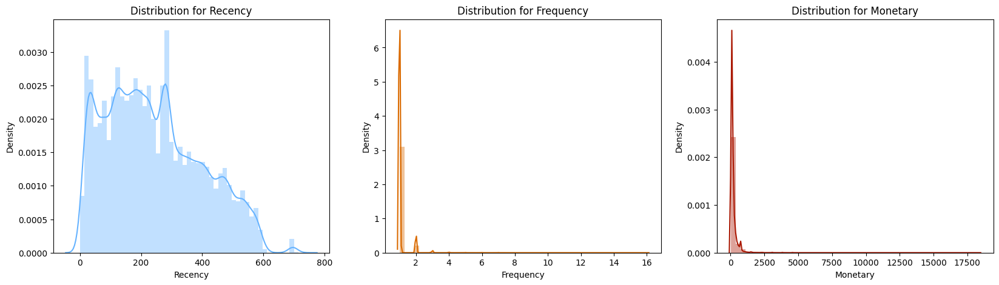

In [169]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))

def plot_distribution(ax, data, column, color, title):
    sns.distplot(data[column], color=color, ax=ax)
    ax.set_title(f'Distribution for {title}')

plot_distribution(axes[0], data_rfm_kmeans, 'Recency', "#66b3ff", 'Recency')
plot_distribution(axes[1], data_rfm_kmeans, 'Frequency', "#DA6A00", 'Frequency')
plot_distribution(axes[2], data_rfm_kmeans, 'Monetary', "#AA1803", 'Monetary')

plt.show()

F and M are skewed.

C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\151595622.py:9: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\151595622.py:9: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\151595622.py:9: UserWarning:



`distplot` is a 

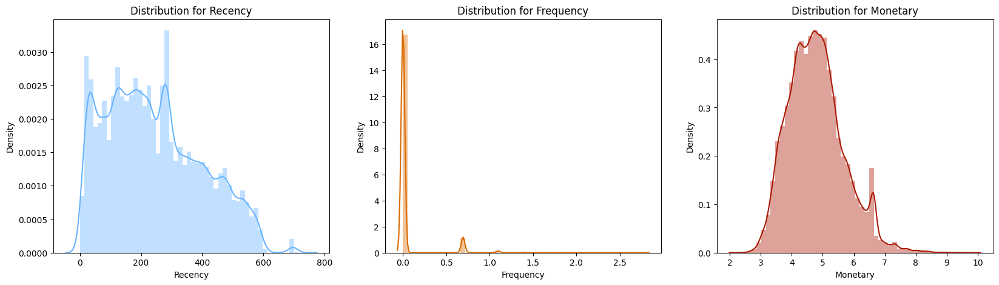

In [170]:
cols_to_log = ['Frequency', 'Monetary']

for col in cols_to_log:
    data_rfm_kmeans[col] = np.log(data_rfm_kmeans[col])

fig, axes = plt.subplots(1, 3, figsize=(20, 5))

def plot_distribution(ax, data, column, color, title):
    sns.distplot(data[column], color=color, ax=ax)
    ax.set_title(f'Distribution for {title}')

plot_distribution(axes[0], data_rfm_kmeans, 'Recency', "#66b3ff", 'Recency')
plot_distribution(axes[1], data_rfm_kmeans, 'Frequency', "#DA6A00", 'Frequency')
plot_distribution(axes[2], data_rfm_kmeans, 'Monetary', "#AA1803", 'Monetary')

plt.show()

Adding extra features to the dataframe per customer 

In [172]:
aggregated_data = data_train.groupby('customer_unique_id').agg({
    'freight_value': 'sum',
    'delivery_days': 'mean',
    'review_score': 'mean',
    'length_reviews_comment': 'mean',
    'number_reviews': 'mean'
}).reset_index()

data_cluster = data_rfm_kmeans.merge(aggregated_data, how='left', on='customer_unique_id')

data_cluster['avg_comment'] = data_cluster['length_reviews_comment'] / data_cluster['number_reviews']
data_cluster.drop(['length_reviews_comment', 'number_reviews'], axis=1, inplace=True)
data_cluster

,customer_unique_id,Recency,Frequency,Monetary,freight_value,delivery_days,review_score,avg_comment
0,0000366f3b9a7992bf8c76cfdf3221e2,116,0.693147,4.955123,12.00,4.0,5.0,111.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,119,0.693147,3.302849,8.29,4.0,4.0,0.0
2,0000f46a3911fa3c0805444483337064,542,0.693147,4.456902,17.22,1.0,3.0,0.0
3,0000f6ccb0745a6a4b88665a16c9f078,326,0.000000,3.775516,17.63,11.0,4.0,12.0
4,0004aac84e0df4da2b147fca70cf8255,293,0.000000,5.282645,16.89,7.0,5.0,0.0
...,...,...,...,...,...,...,...,...
94715,fffcf5a5ff07b0908bd4e2dbc735a684,452,0.000000,7.334212,121.22,26.0,5.0,0.0
94716,fffea47cd6d3cc0a88bd621562a9d061,267,0.000000,4.437698,19.69,2.0,4.0,0.0
94717,ffff371b4d645b6ecea244b27531430a,573,0.000000,4.722598,22.56,29.0,5.0,0.0
94718,ffff5962728ec6157033ef9805bacc48,124,0.000000,4.895524,18.69,13.0,5.0,133.0


Scaling the data for better calculation

In [175]:
scaler = MinMaxScaler()

columns_to_scale = data_cluster.iloc[:, 1:8].columns
data_cluster_scaled = pd.DataFrame(scaler.fit_transform(data_cluster[columns_to_scale]), columns=columns_to_scale)

<Axes: ylabel='Frequency'>

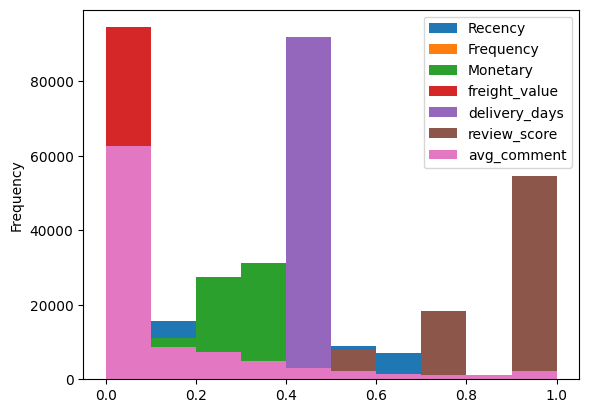

In [176]:
data_cluster_scaled.plot(kind='hist')

### Unsupervised machine learning

Silhouette Score:

    Range: -1 to 1
    Interpretation:
        Near 1: Data points are compact within their clusters and well-separated from other clusters
        Near 0: Overlapping clusters.
        Near -1: Data points may be assigned to the wrong clusters.
    Calculation: (b - a) / max(a, b), where a is the mean intra-cluster distance, and b is the mean nearest-cluster distance.
    Note: Silhouette Coefficient is meaningful for 2 <= n_labels <= n_samples - 1

Calinski-Harabasz Score:

    Also known as the Variance Ratio Criterion.
    Interpretation:
        Higher score: Better-defined clusters.
    Calculation: Ratio of the sum of between-cluster dispersion to within-cluster dispersion

Davies-Bouldin Score:

    Interpretation:
        Minimum score is zero.
        Lower values indicate better clustering.
    Calculation: Average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances.
        Clusters that are farther apart and less dispersed result in a better score

In [191]:
def plot_rmf(data, label):
    plot_scatter_matrix(data, label)
    plot_radar(data, label)
    plot_hist(data, label)

def plot_scatter_matrix(data, label):
    fig, axes = plt.subplots(1, 3, figsize=(20, 5))
    scatter_plot(data, 'Frequency', 'Monetary', label, axes[0], 'Frequency V Monetary')
    scatter_plot(data, 'Recency', 'Monetary', label, axes[1], 'Recency V Monetary')
    scatter_plot(data, 'Frequency', 'Recency', label, axes[2], 'Frequency V Recency')
    plt.show()

def scatter_plot(data, x, y, hue, ax, title):
    sns.set_context(context='notebook', font_scale=1)
    sns.scatterplot(x=x, y=y, hue=hue, data=data, palette='Set1', ax=ax)
    ax.set_title(title)
    ax.set_ylabel(y)
    ax.set_xlabel(x)

def plot_radar(data, label):
    aggregated_data = aggregate_data(data, label)
    categories = list(aggregated_data)[1:]
    plot_spider_chart(aggregated_data, categories)

def aggregate_data(data, label):
    return data.groupby([label], as_index=False).agg({
        'Recency': 'mean',
        'Frequency': 'mean',
        'Monetary': 'mean',
        'freight_value': 'mean',
        'review_score': 'mean',
        'delivery_days': 'mean',
        'avg_comment': 'mean',
    })

def plot_spider_chart(data, categories):
    N = len(categories)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    
    plt.figure(figsize=(10, 10))
    ax = plt.subplot(111, polar=True)
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    
    plt.xticks(angles[:-1], categories)
    ax.set_rlabel_position(0)
    plt.yticks([0.2, 0.4, 0.6, 0.8, 1], ['0.2', '0.4', '0.6', '0.8', '1'], color="grey", size=7)
    plt.ylim(0, 1)

    for x in range(len(data)):
        values = data.loc[x].drop(label).values.flatten().tolist()
        values += values[:1]
        ax.plot(angles, values, linewidth=1.5, linestyle='solid', label=f"Cluster : {x}")
        ax.fill(angles, values, alpha=0.2)
    
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
    plt.title("Radar map of features and cluster")
    plt.show()

def plot_hist(data, huelabel):
    fig, axs = plt.subplots(2, 4, figsize=(20, 10))
    kde_plot(data, 'Recency', axs[0, 0], huelabel)
    kde_plot(data, 'Frequency', axs[0, 1], huelabel)
    kde_plot(data, 'Monetary', axs[0, 2], huelabel)
    kde_plot(data, 'freight_value', axs[0, 3], huelabel)
    kde_plot(data, 'review_score', axs[1, 0], huelabel)
    kde_plot(data, 'delivery_days', axs[1, 1], huelabel)
    kde_plot(data, 'avg_comment', axs[1, 2], huelabel)
    plt.show()

def kde_plot(data, x, ax, hue):
    sns.kdeplot(data=data, x=x, ax=ax, hue=hue, palette='Set2')

## Kmeans

c:\Users\bonad\repos\olist_segmentation\olist_segmentation\.venv\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\bonad\repos\olist_segmentation\olist_segmentation\.venv\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\2222720177.py:17: UserWarning:

color is redundantly defined by the 'color' keyword argument and the fmt string "bx-" (-> color='b'). The keyword argument will take precedence.



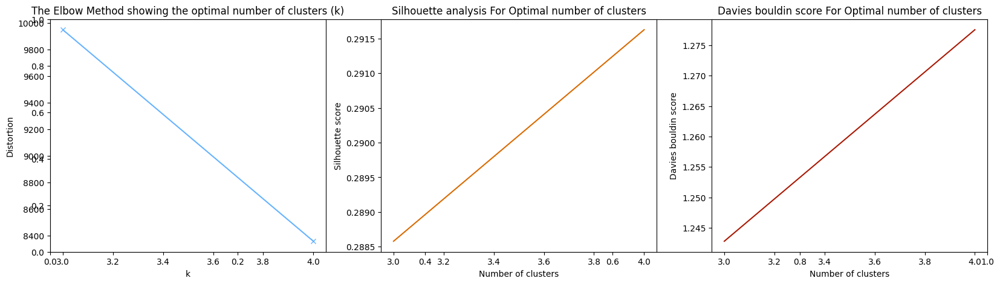

In [192]:
def evaluate_clusters(data, range_n_clusters):
    dist_values, sil_scores, davies_scores = [], [], []

    for k in range_n_clusters:
        kmean_model = KMeans(n_clusters=k)
        kmean_model.fit(data)
        dist_values.append(kmean_model.inertia_)
        sil_scores.append(silhouette_score(data, kmean_model.labels_))
        davies_scores.append(davies_bouldin_score(data, kmean_model.labels_))

    return dist_values, sil_scores, davies_scores

def plot_evaluation(range_n_clusters, dist_values, sil_scores, davies_scores):
    plt.subplots(figsize=(20, 5))

    plt.subplot(1, 3, 1)
    plt.plot(range_n_clusters, dist_values, 'bx-', color="#66b3ff")
    plt.xlabel('k')
    plt.ylabel('Distortion')
    plt.title('The Elbow Method showing the optimal number of clusters (k)')

    plt.subplot(1, 3, 2)
    plt.plot(range_n_clusters, sil_scores, color="#DA6A00")
    plt.xlabel('Number of clusters')
    plt.ylabel('Silhouette score')
    plt.title('Silhouette analysis For Optimal number of clusters')

    plt.subplot(1, 3, 3)
    plt.plot(range_n_clusters, davies_scores, color="#AA1803")
    plt.xlabel('Number of clusters')
    plt.ylabel('Davies bouldin score')
    plt.title('Davies bouldin score For Optimal number of clusters')

    plt.show()

# Assuming data_cluster_scaled is your data
range_n_clusters = range(3, 14)
dist_values, sil_scores, davies_scores = evaluate_clusters(data_cluster_scaled, range_n_clusters)
plot_evaluation(range_n_clusters, dist_values, sil_scores, davies_scores)

As per all the metrics we are defining the clustering size to 6

In [194]:
def apply_kmeans(data, n_clusters=6):
    kmeans_model = KMeans(n_clusters=n_clusters)
    kmeans_model.fit(data)
    
    clustered_data = data.copy()
    clustered_data['labels_kmeans'] = kmeans_model.labels_

    rfm_labels = pd.DataFrame(data=kmeans_model.labels_, columns=['kmeans'])
    
    cluster_summary = grouped_summary(clustered_data, kmeans_model.labels_)
    
    return clustered_data, rfm_labels, cluster_summary

def grouped_summary(data, labels):
    return data.groupby(['labels_kmeans']).agg({
        'Recency': 'mean',
        'Frequency': 'mean',
        'Monetary': ['mean', 'count'],
        'freight_value': 'mean',
        'review_score': ['mean', 'count'],
        'delivery_days': 'mean',
        'avg_comment': 'mean',
    })

clustered_kmeans, rfm_labels, cluster_summary = apply_kmeans(data_cluster_scaled)
print(cluster_summary)

c:\Users\bonad\repos\olist_segmentation\olist_segmentation\.venv\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



                Recency Frequency  Monetary        freight_value review_score  \
                   mean      mean      mean  count          mean         mean   
labels_kmeans                                                                   
0              0.196206  0.020565  0.328557  32318      0.012894     0.999176   
1              0.338694  0.019670  0.354521   8743      0.015772     0.060535   
2              0.330627  0.020895  0.343995   7694      0.013691     0.894305   
3              0.340658  0.019805  0.374874   5406      0.016353     0.115483   
4              0.589259  0.019694  0.329591  22690      0.012911     0.935989   
5              0.255161  0.020583  0.329682  17869      0.013705     0.665832   

                     delivery_days avg_comment  
               count          mean        mean  
labels_kmeans                                   
0              32318      0.446262    0.042159  
1               8743      0.454128    0.150492  
2               7694     

In [199]:
def calculate_clustering_scores(data, labels):
    silhouette = silhouette_score(data, labels)
    calinski_harabasz = calinski_harabasz_score(data, labels)
    davies_bouldin = davies_bouldin_score(data, labels)
    
    return silhouette, calinski_harabasz, davies_bouldin

def update_score_dataframe(dataframe, model, num_clusters, silhouette, calinski_harabasz, davies_bouldin):
    dataframe.loc[len(dataframe)] = [model, num_clusters, silhouette, calinski_harabasz, davies_bouldin]

# Assuming data_cluster_scaled and kmeansSelected.labels_ are defined
data_score_clustering = pd.DataFrame(columns=['Model', 'Number_of_cluster', 'silhouette_score', 'calinski_harabasz_score', 'davies_bouldin_score'])

# Calculate scores
silhouette, calinski_harabasz, davies_bouldin = calculate_clustering_scores(data_cluster_scaled, kmeansSelected.labels_)

# Update the dataframe
update_score_dataframe(data_score_clustering, "Kmeans", 6, silhouette, calinski_harabasz, davies_bouldin)

# Print the scores
print("kmeans Silhouette score with 6 clusters:", data_score_clustering.loc[0]['silhouette_score'])
print("kmeans Calinski harabasz score with 6 clusters:", data_score_clustering.loc[0]['calinski_harabasz_score'])
print("kmeans Davies bouldin score with 6 clusters:", data_score_clustering.loc[0]['davies_bouldin_score'])

kmeans Silhouette score with 6 clusters: 0.30281604792688815
kmeans Calinski harabasz score with 6 clusters: 46534.632611575755
kmeans Davies bouldin score with 6 clusters: 1.1220001513575433


In [205]:
def plot_3d_scatter(data, x, y, z, color, width=1000, height=700):
    fig = px.scatter_3d(data, x=x, y=y, z=z, color=color, width=width, height=height)
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    return fig

# Assuming clustered_kmeans is your data
fig2 = plot_3d_scatter(clustered_kmeans, 'Recency', 'Frequency', 'Monetary', 'labels_kmeans')
fig2

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': ('Recency=%{x}<br>Frequency=%{y}' ... '%{marker.color}<extra></extra>'),
              'legendgroup': '',
              'marker': {'color': array([2, 5, 4, ..., 4, 2, 4]), 'coloraxis': 'coloraxis', 'symbol': 'circle'},
              'mode': 'markers',
              'name': '',
              'scene': 'scene',
              'showlegend': False,
              'type': 'scatter3d',
              'x': array([0.15912209, 0.16323731, 0.74348422, ..., 0.78600823, 0.17009602,
                          0.67078189]),
              'y': array([0.25, 0.25, 0.25, ..., 0.  , 0.  , 0.  ]),
              'z': array([0.3564779 , 0.13787689, 0.29056176, ..., 0.32571411, 0.34859278,
                          0.26590495])}],
    'layout': {'coloraxis': {'colorbar': {'title': {'text': 'labels_kmeans'}},
                             'colorscale': [[0.0, '#0d0887'], [0.1111111111111111,
                                            '#46039f'], [0.2222222222222222,
                                            '#7201a8'], [0.3333333333333333,
                                            '#9c179e'], [0.4444444444444444,
                                            '#bd3786'], [0.5555555555555556,
                                            '#d8576b'], [0.6666666666666666,
                                            '#ed7953'], [0.7777777777777778,
                                            '#fb9f3a'], [0.8888888888888888,
                                            '#fdca26'], [1.0, '#f0f921']]},
               'height': 700,
               'legend': {'tracegroupgap': 0},
               'margin': {'b': 0, 'l': 0, 'r': 0, 't': 0},
               'scene': {'domain': {'x': [0.0, 1.0], 'y': [0.0, 1.0]},
                         'xaxis': {'title': {'text': 'Recency'}},
                         'yaxis': {'title': {'text': 'Frequency'}},
                         'zaxis': {'title': {'text': 'Monetary'}}},
               'template': '...',
               'width': 1000}
})

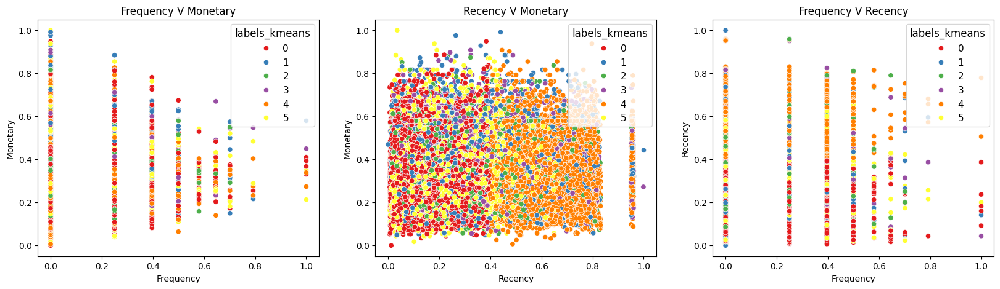

NameError: name 'label' is not defined

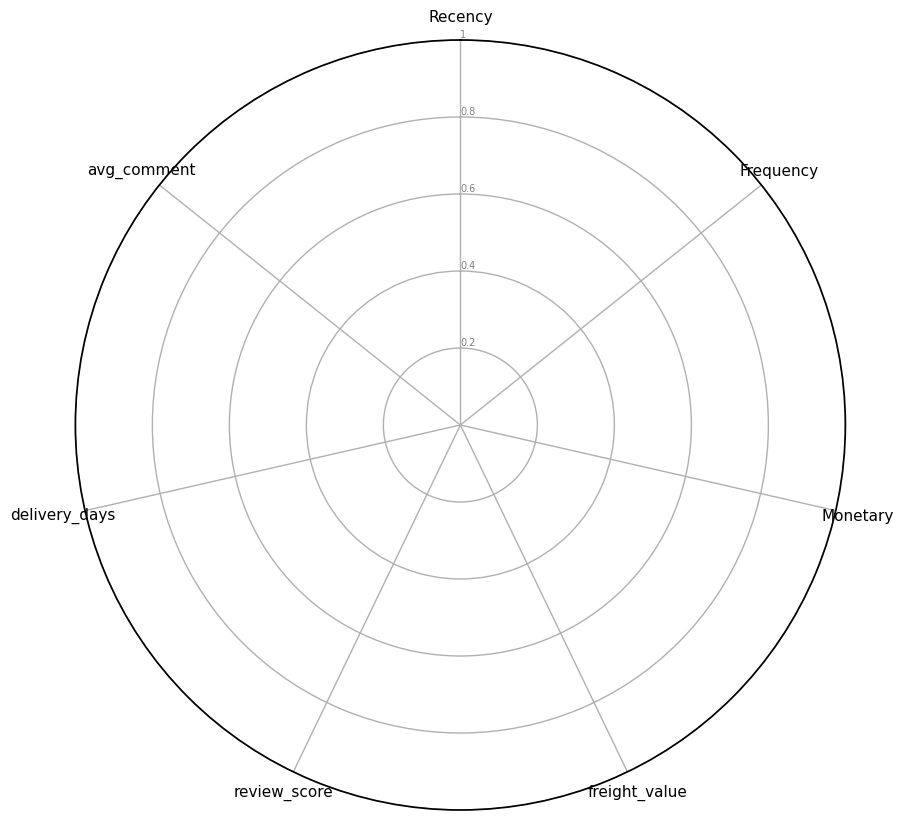

In [206]:
plot_rmf(clustered_kmeans, 'labels_kmeans')

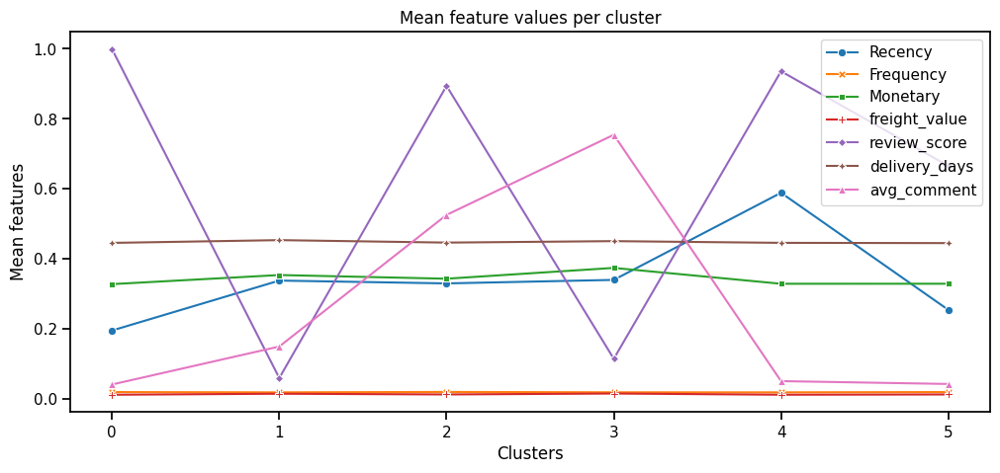

In [211]:
group_column = 'labels_kmeans'

group_kmeans = clustered_kmeans.groupby([group_column], as_index=False).agg({
    'Recency': 'mean',
    'Frequency': 'mean',
    'Monetary': 'mean',
    'freight_value': 'mean',
    'review_score': 'mean',
    'delivery_days': 'mean',
    'avg_comment': 'mean',
})

plt.figure(figsize=(12, 5))
sns.lineplot(data=group_kmeans.iloc[:, 1:], markers=True, dashes=False)
plt.xlabel("Clusters")
plt.ylabel("Mean features")
plt.title("Mean feature values per cluster")

plt.show()

In [212]:
group_kmeans.round(2)

,labels_kmeans,Recency,Frequency,Monetary,freight_value,review_score,delivery_days,avg_comment
0,0,0.20,0.02,0.33,0.01,1.00,0.45,0.04
1,1,0.34,0.02,0.35,0.02,0.06,0.45,0.15
2,2,0.33,0.02,0.34,0.01,0.89,0.45,0.53
3,3,0.34,0.02,0.37,0.02,0.12,0.45,0.75
4,4,0.59,0.02,0.33,0.01,0.94,0.45,0.05
5,5,0.26,0.02,0.33,0.01,0.67,0.45,0.04


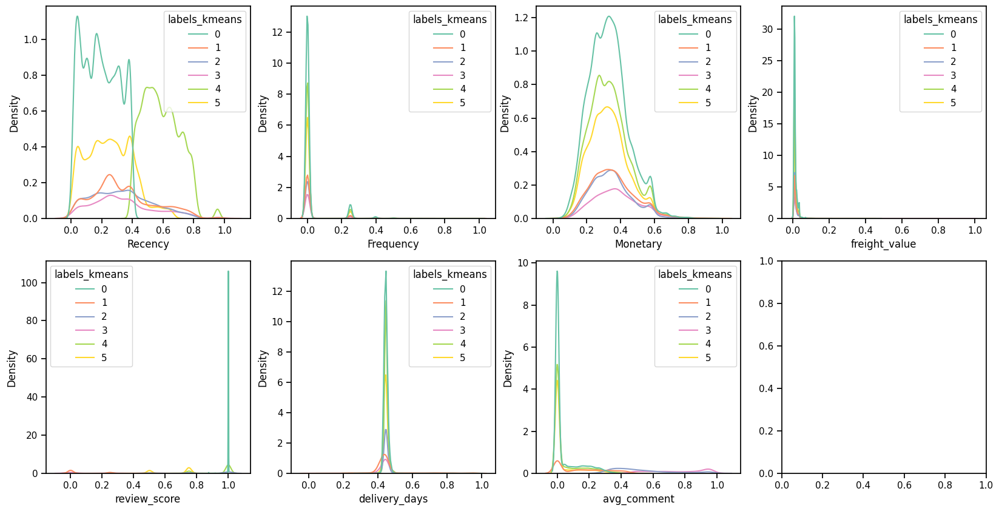

In [213]:
plothist(clustered_kmeans, 'labels_kmeans')

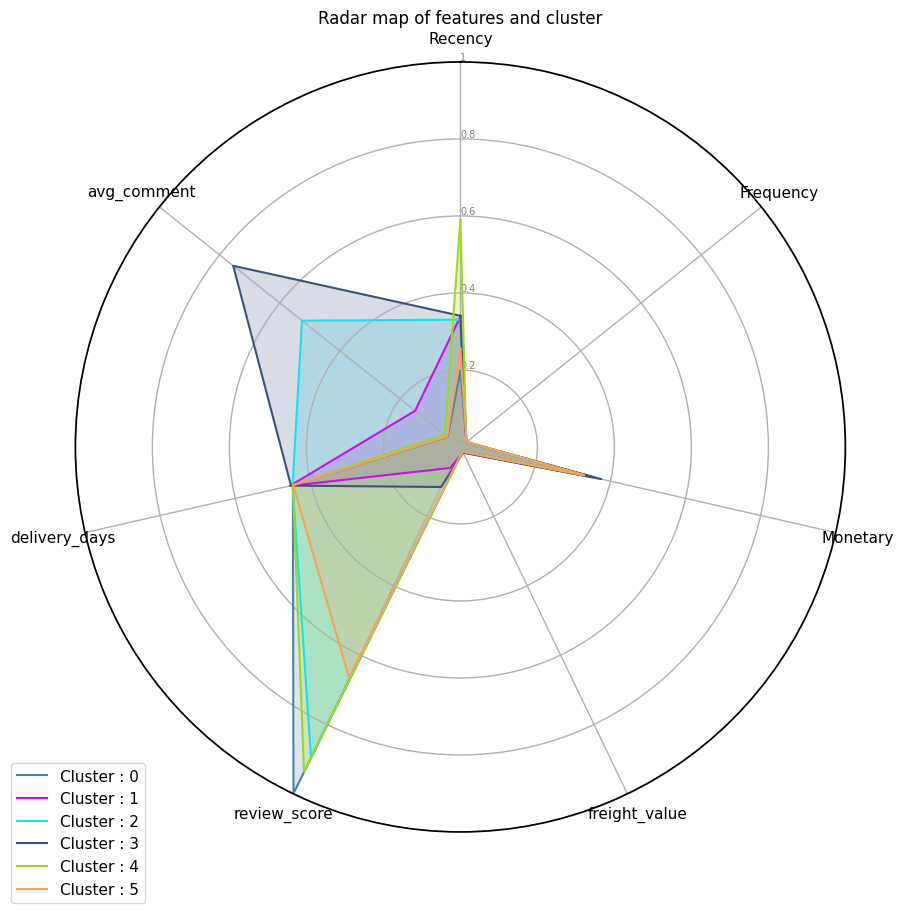

In [215]:
radar_plot(clustered_kmeans, 'labels_kmeans')

## Gaussian Mixture clustering

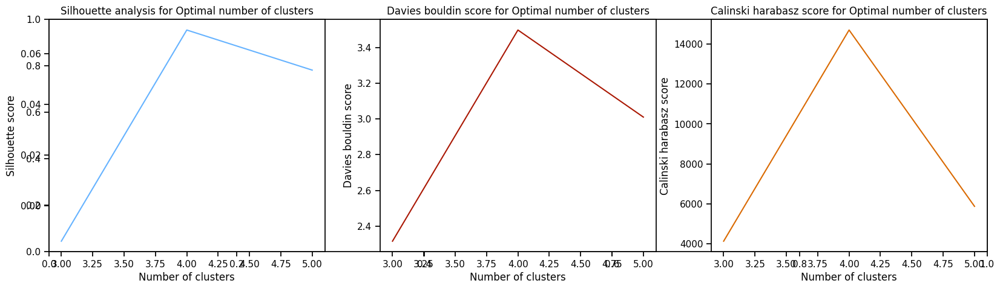

In [221]:
def evaluate_gmm(data, n_components):
    sil_scores, davies_scores, cal_scores = [], [], []
    
    for k in n_components:
        gmm = GaussianMixture(n_components=k)
        gmm.fit(data)
        pred = gmm.predict(data)
        
        sil_scores.append(silhouette_score(data, pred))
        davies_scores.append(davies_bouldin_score(data, pred))
        cal_scores.append(calinski_harabasz_score(data, pred))
    
    return sil_scores, davies_scores, cal_scores

def plot_scores(n_components, sil_scores, davies_scores, cal_scores):
    plt.subplots(figsize=(20, 5))

    plt.subplot(1, 3, 1)
    plt.plot(n_components, sil_scores, color="#66b3ff")
    plt.xlabel('Number of clusters') 
    plt.ylabel('Silhouette score') 
    plt.title('Silhouette analysis for Optimal number of clusters')

    plt.subplot(1, 3, 2)
    plt.plot(n_components, davies_scores, color="#AA1803")
    plt.xlabel('Number of clusters') 
    plt.ylabel('Davies bouldin score') 
    plt.title('Davies bouldin score for Optimal number of clusters')

    plt.subplot(1, 3, 3)
    plt.plot(n_components, cal_scores, color="#DA6A00")
    plt.xlabel('Number of clusters') 
    plt.ylabel('Calinski harabasz score') 
    plt.title('Calinski harabasz score for Optimal number of clusters')

data_cluster_scaled
n_components = range(3, 14)

sil_score_gmm, davies_score_gmm, cal_score_gmm = evaluate_gmm(data_cluster_scaled, n_components)
plot_scores(n_components, sil_score_gmm, davies_score_gmm, cal_score_gmm)

plt.show()

Comparing the matrix 5 number of clusters will be optimum for the clustring

In [223]:
def fit_gmm_and_label_data(data, n_components=5):
    cluster_gmm = GaussianMixture(n_components=n_components)
    cluster_gmm.fit(data)
    
    clustered_data = data.copy()
    clustered_data['labels_gmm'] = cluster_gmm.predict(data)
    
    return cluster_gmm, clustered_data

def analyze_clusters(data, cluster_column='labels_gmm'):
    grouped_data = data.groupby([cluster_column]).agg({
        'Recency': 'mean',
        'Frequency': 'mean',
        'Monetary': ['mean', 'count'],
        'freight_value': 'mean',
        'review_score': 'mean',
        'delivery_days': 'mean',
        'avg_comment': 'mean',
    })
    
    return grouped_data
cluster_gmm_model, clustered_gmm_data = fit_gmm_and_label_data(data_cluster_scaled)
cluster_analysis_result = analyze_clusters(clustered_gmm_data)

print(cluster_analysis_result)

             Recency Frequency  Monetary        freight_value review_score  \
                mean      mean      mean  count          mean         mean   
labels_gmm                                                                   
0           0.335929  0.000000  0.325234  11470      0.012344     0.750000   
1           0.340718  0.135639  0.305940   7874      0.010618     0.642670   
2           0.348499  0.151247  0.387819   5627      0.027035     0.530606   
3           0.329495  0.000000  0.327609  49146      0.012259     1.000000   
4           0.336218  0.000000  0.356178  20603      0.014871     0.372104   

           delivery_days avg_comment  
                    mean        mean  
labels_gmm                            
0               0.444644    0.000012  
1               0.443644    0.000002  
2               0.497458    0.278597  
3               0.446104    0.076043  
4               0.439093    0.361806  


In [230]:
data_score_clustering.loc[1] = ["Gaussian mixture",
                                5,
                                silhouette_score(data_cluster_scaled, clustered_gmm['labels_gmm']),
                                calinski_harabasz_score(data_cluster_scaled, clustered_gmm['labels_gmm']),
                                davies_bouldin_score(data_cluster_scaled, clustered_gmm['labels_gmm'])]


print("Silhouette score for 5 cluster from model Gaussian mixture", data_score_clustering.loc[1]['silhouette_score'])
print("Calinski harabasz score for 5 cluster from model Gaussian mixture", data_score_clustering.loc[1]['calinski_harabasz_score'])
print("Davies bouldin score for 5 cluster from model Gaussian mixture", data_score_clustering.loc[1]['davies_bouldin_score'])

Silhouette score for 5 cluster from model Gaussian mixture 0.1945099750408669
Calinski harabasz score for 5 cluster from model Gaussian mixture 22710.958928365268
Davies bouldin score for 5 cluster from model Gaussian mixture 2.934921060016206


In [231]:
def create_3d_scatter_plot(data, x, y, z, color, width=1000, height=700):
    fig = px.scatter_3d(data, x=x, y=y, z=z, color=color, width=width, height=height)
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    return fig

# Assuming clustered_gmm is your DataFrame
fig3 = create_3d_scatter_plot(clustered_gmm, 'Recency', 'Frequency', 'Monetary', 'labels_gmm')
fig3

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': ('Recency=%{x}<br>Frequency=%{y}' ... '%{marker.color}<extra></extra>'),
              'legendgroup': '',
              'marker': {'color': array([4, 2, 2, ..., 0, 0, 0], dtype=int64),
                         'coloraxis': 'coloraxis',
                         'symbol': 'circle'},
              'mode': 'markers',
              'name': '',
              'scene': 'scene',
              'showlegend': False,
              'type': 'scatter3d',
              'x': array([0.15912209, 0.16323731, 0.74348422, ..., 0.78600823, 0.17009602,
                          0.67078189]),
              'y': array([0.25, 0.25, 0.25, ..., 0.  , 0.  , 0.  ]),
              'z': array([0.3564779 , 0.13787689, 0.29056176, ..., 0.32571411, 0.34859278,
                          0.26590495])}],
    'layout': {'coloraxis': {'colorbar': {'title': {'text': 'labels_gmm'}},
                             'colorscale': [[0.0, '#0d0887'], [0.1111111111111111,
                                            '#46039f'], [0.2222222222222222,
                                            '#7201a8'], [0.3333333333333333,
                                            '#9c179e'], [0.4444444444444444,
                                            '#bd3786'], [0.5555555555555556,
                                            '#d8576b'], [0.6666666666666666,
                                            '#ed7953'], [0.7777777777777778,
                                            '#fb9f3a'], [0.8888888888888888,
                                            '#fdca26'], [1.0, '#f0f921']]},
               'height': 700,
               'legend': {'tracegroupgap': 0},
               'margin': {'b': 0, 'l': 0, 'r': 0, 't': 0},
               'scene': {'domain': {'x': [0.0, 1.0], 'y': [0.0, 1.0]},
                         'xaxis': {'title': {'text': 'Recency'}},
                         'yaxis': {'title': {'text': 'Frequency'}},
                         'zaxis': {'title': {'text': 'Monetary'}}},
               'template': '...',
               'width': 1000}
})

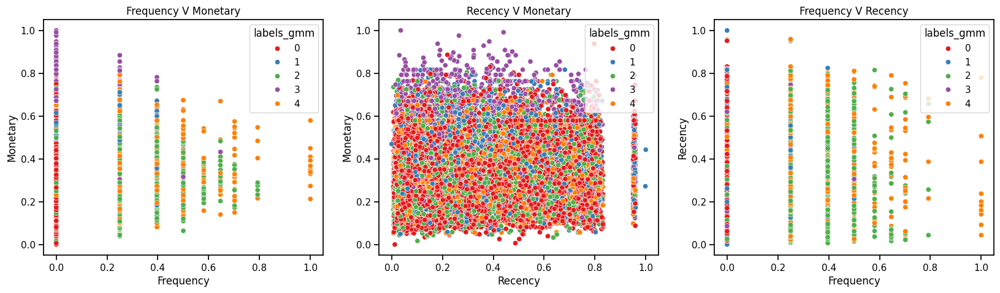

NameError: name 'label' is not defined

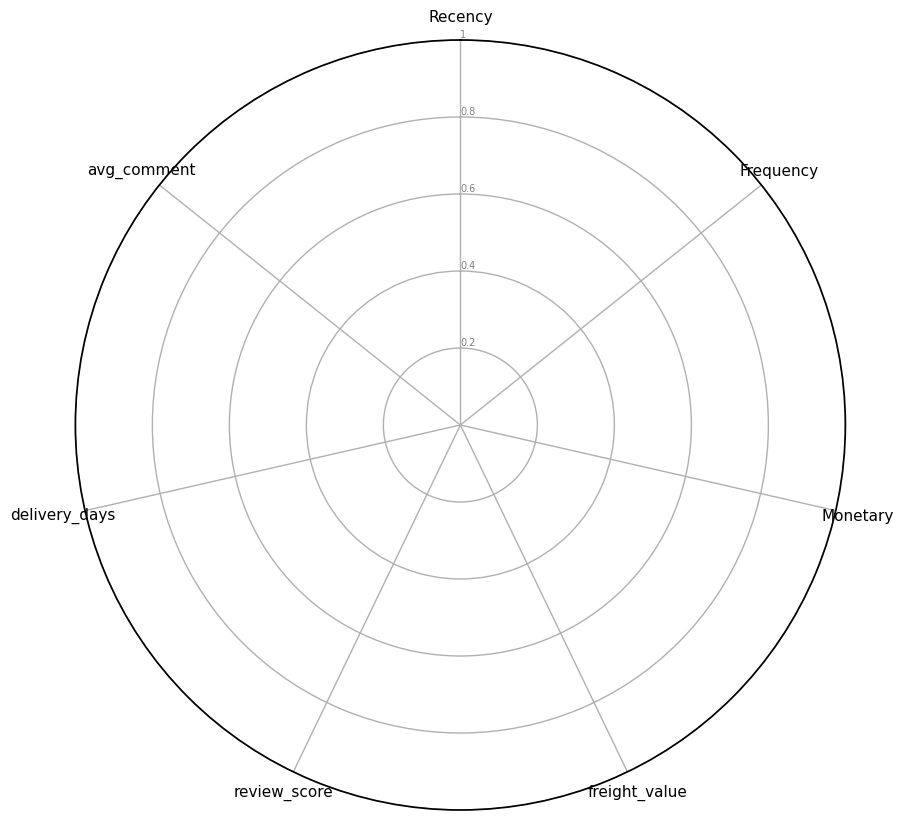

In [233]:
plot_rmf(clustered_gmm, 'labels_gmm')

   labels_gmm  Recency  Frequency  Monetary  freight_value  review_score  \
0           0     0.33       0.00      0.33           0.01          1.00   
1           1     0.34       0.02      0.36           0.01          0.00   
2           2     0.34       0.05      0.32           0.01          0.71   
3           3     0.34       0.02      0.49           0.05          0.62   
4           4     0.34       0.05      0.34           0.01          0.64   

   delivery_days  avg_comment  
0           0.45         0.09  
1           0.46         0.37  
2           0.44         0.00  
3           0.48         0.21  
4           0.44         0.34  


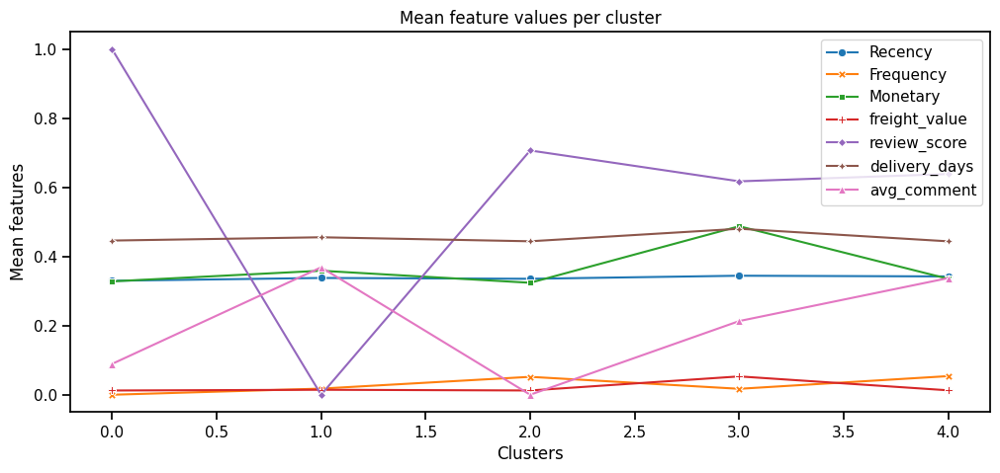

In [242]:
def plot_and_display_cluster_means(data, features, cluster_column='labels_gmm', figsize=(12, 5)):
    group_data = data.groupby([cluster_column], as_index=False).agg(features)
    
    plt.figure(figsize=figsize)
    sns.lineplot(data=group_data.iloc[:, 1:], markers=True, dashes=False)
    plt.xlabel("Clusters")
    plt.ylabel("Mean features")
    plt.title("Mean feature values per cluster")

    display_data = group_data.round(2)
    print(display_data)
    return display_data

features_to_plot = {
    'Recency': 'mean',
    'Frequency': 'mean',
    'Monetary': 'mean',
    'freight_value': 'mean',
    'review_score': 'mean',
    'delivery_days': 'mean',
    'avg_comment': 'mean',
}

cluster_means_data = plot_and_display_cluster_means(clustered_gmm, features_to_plot)

In [241]:
group_gmm.round(2)

NameError: name 'group_gmm' is not defined

C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\1613233668.py:102: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

C:\Users\bonad\AppData\Local\Temp\ipykernel_20636\1613233668.py:105: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



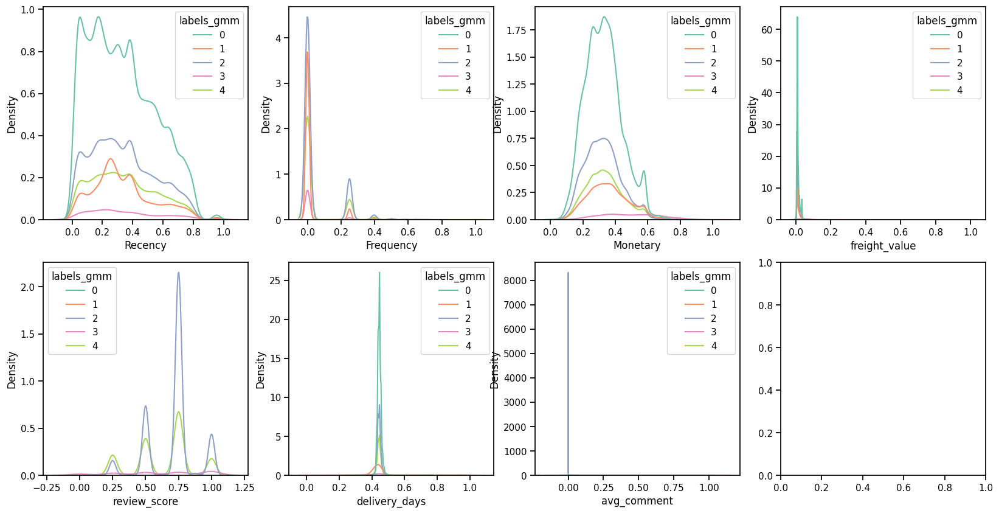

In [235]:
plothist(clustered_gmm, 'labels_gmm')

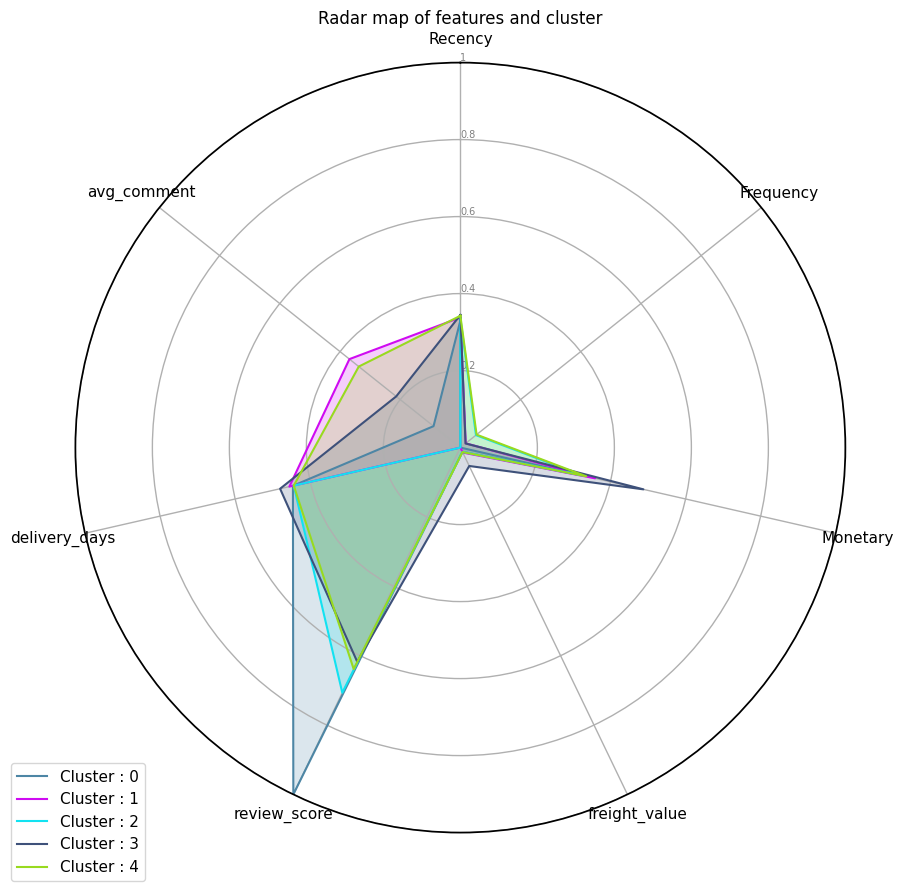

In [243]:
radar_plot(clustered_gmm, 'labels_gmm')

## Birch

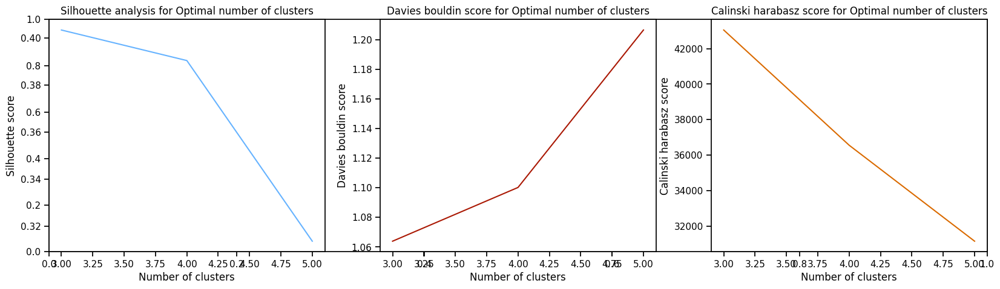

In [245]:
def evaluate_birch(data, n_components):
    sil_scores, davies_scores, cal_scores = [], [], []
    
    for k in n_components:
        birch = Birch(branching_factor=50, n_clusters=k, threshold=0.35)
        brc_model = birch.fit(data)
        labels = brc_model.labels_
        
        sil_scores.append(silhouette_score(data, labels))
        davies_scores.append(davies_bouldin_score(data, labels))
        cal_scores.append(calinski_harabasz_score(data, labels))
    
    return sil_scores, davies_scores, cal_scores

def plot_evaluation_scores(n_components, sil_scores, davies_scores, cal_scores):
    plt.subplots(figsize=(20, 5))

    plt.subplot(1, 3, 1)
    plt.plot(n_components, sil_scores, color="#66b3ff")
    plt.xlabel('Number of clusters') 
    plt.ylabel('Silhouette score') 
    plt.title('Silhouette analysis for Optimal number of clusters')

    plt.subplot(1, 3, 2)
    plt.plot(n_components, davies_scores, color="#AA1803")
    plt.xlabel('Number of clusters') 
    plt.ylabel('Davies bouldin score') 
    plt.title('Davies bouldin score for Optimal number of clusters')

    plt.subplot(1, 3, 3)
    plt.plot(n_components, cal_scores, color="#DA6A00")
    plt.xlabel('Number of clusters') 
    plt.ylabel('Calinski harabasz score') 
    plt.title('Calinski harabasz score for Optimal number of clusters')

# Assuming data_cluster_scaled is your input data
n_components = range(3, 14)

sil_score_birch, davies_score_birch, cal_score_birch = evaluate_birch(data_cluster_scaled, n_components)
plot_evaluation_scores(n_components, sil_score_birch, davies_score_birch, cal_score_birch)

plt.show()

Comparing the metrics optimum number of cluster  is 4

In [246]:
def cluster_and_analyze_birch(data, n_clusters=4, branching_factor=50, threshold=0.35):
    cluster_brc = Birch(branching_factor=branching_factor, n_clusters=n_clusters, threshold=threshold)
    
    clustered_brc = data.copy()
    clustered_brc['labels_brc'] = cluster_brc.fit(data).labels_
    
    cluster_analysis_result = clustered_brc.groupby(['labels_brc']).agg({
        'Recency': 'mean',
        'Frequency': 'mean',
        'Monetary': ['mean', 'count'],
        'freight_value': 'mean',
        'review_score': ['mean', 'count'],
        'delivery_days': 'mean',
        'avg_comment': 'mean',
    })
    
    return clustered_brc, cluster_analysis_result

clustered_brc_data, cluster_analysis_result_brc = cluster_and_analyze_birch(data_cluster_scaled)

print(cluster_analysis_result_brc)

             Recency Frequency  Monetary        freight_value review_score  \
                mean      mean      mean  count          mean         mean   
labels_brc                                                                   
0           0.299538  0.013811  0.348619  14786      0.015437     0.232346   
1           0.331349  0.020541  0.328976  71259      0.012976     0.927796   
2           0.447415  0.021114  0.352476   4325      0.014179     0.852282   
3           0.377416  0.036743  0.376787   4350      0.016548     0.051871   

                  delivery_days avg_comment  
            count          mean        mean  
labels_brc                                   
0           14786      0.453075    0.155546  
1           71259      0.446070    0.061113  
2            4325      0.447313    0.659839  
3            4350      0.446683    0.747309  


In [253]:
data_score_clustering.loc[2] = ["Birch", 
                                4,
                                silhouette_score(data_cluster_scaled, clustered_brc_data['labels_brc']),
                                calinski_harabasz_score(data_cluster_scaled, clustered_brc_data['labels_brc']),
                                davies_bouldin_score(data_cluster_scaled, clustered_brc_data['labels_brc'])]


print("Silhouette score for 4 cluster from model Birch", data_score_clustering.loc[2]['silhouette_score'])
print("Calinski harabasz score for 4 cluster from model Birch", data_score_clustering.loc[2]['calinski_harabasz_score'])
print("Davies bouldin score for 4 cluster from model Birch", data_score_clustering.loc[2]['davies_bouldin_score'])

Silhouette score for 4 cluster from model Birch 0.390287931056855
Calinski harabasz score for 4 cluster from model Birch 36563.92212775132
Davies bouldin score for 4 cluster from model Birch 1.1002224722955882


In [257]:
def plot_3d_scatter(data, x, y, z, color, width=1000, height=700):
    fig = px.scatter_3d(data, x=x, y=y, z=z, color=color, width=width, height=height)
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    return fig
# Assuming clustered_brc_data is your DataFrame
fig3 = plot_3d_scatter(clustered_brc_data, 'Recency', 'Frequency', 'Monetary', 'labels_brc')
fig3

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': ('Recency=%{x}<br>Frequency=%{y}' ... '%{marker.color}<extra></extra>'),
              'legendgroup': '',
              'marker': {'color': array([1, 1, 1, ..., 1, 1, 1], dtype=int64),
                         'coloraxis': 'coloraxis',
                         'symbol': 'circle'},
              'mode': 'markers',
              'name': '',
              'scene': 'scene',
              'showlegend': False,
              'type': 'scatter3d',
              'x': array([0.15912209, 0.16323731, 0.74348422, ..., 0.78600823, 0.17009602,
                          0.67078189]),
              'y': array([0.25, 0.25, 0.25, ..., 0.  , 0.  , 0.  ]),
              'z': array([0.3564779 , 0.13787689, 0.29056176, ..., 0.32571411, 0.34859278,
                          0.26590495])}],
    'layout': {'coloraxis': {'colorbar': {'title': {'text': 'labels_brc'}},
                             'colorscale': [[0.0, '#0d0887'], [0.1111111111111111,
                                            '#46039f'], [0.2222222222222222,
                                            '#7201a8'], [0.3333333333333333,
                                            '#9c179e'], [0.4444444444444444,
                                            '#bd3786'], [0.5555555555555556,
                                            '#d8576b'], [0.6666666666666666,
                                            '#ed7953'], [0.7777777777777778,
                                            '#fb9f3a'], [0.8888888888888888,
                                            '#fdca26'], [1.0, '#f0f921']]},
               'height': 700,
               'legend': {'tracegroupgap': 0},
               'margin': {'b': 0, 'l': 0, 'r': 0, 't': 0},
               'scene': {'domain': {'x': [0.0, 1.0], 'y': [0.0, 1.0]},
                         'xaxis': {'title': {'text': 'Recency'}},
                         'yaxis': {'title': {'text': 'Frequency'}},
                         'zaxis': {'title': {'text': 'Monetary'}}},
               'template': '...',
               'width': 1000}
})

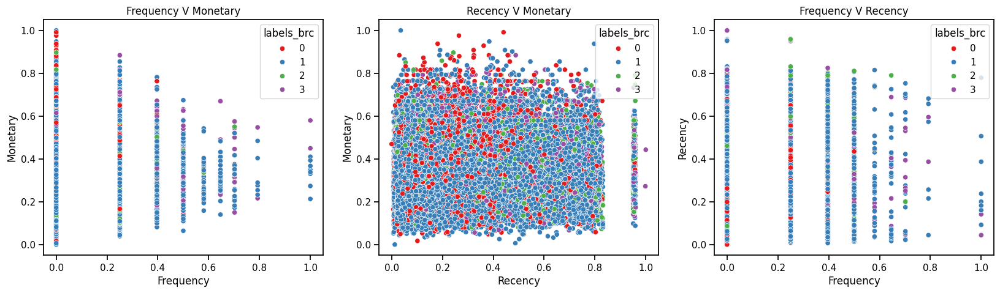

NameError: name 'label' is not defined

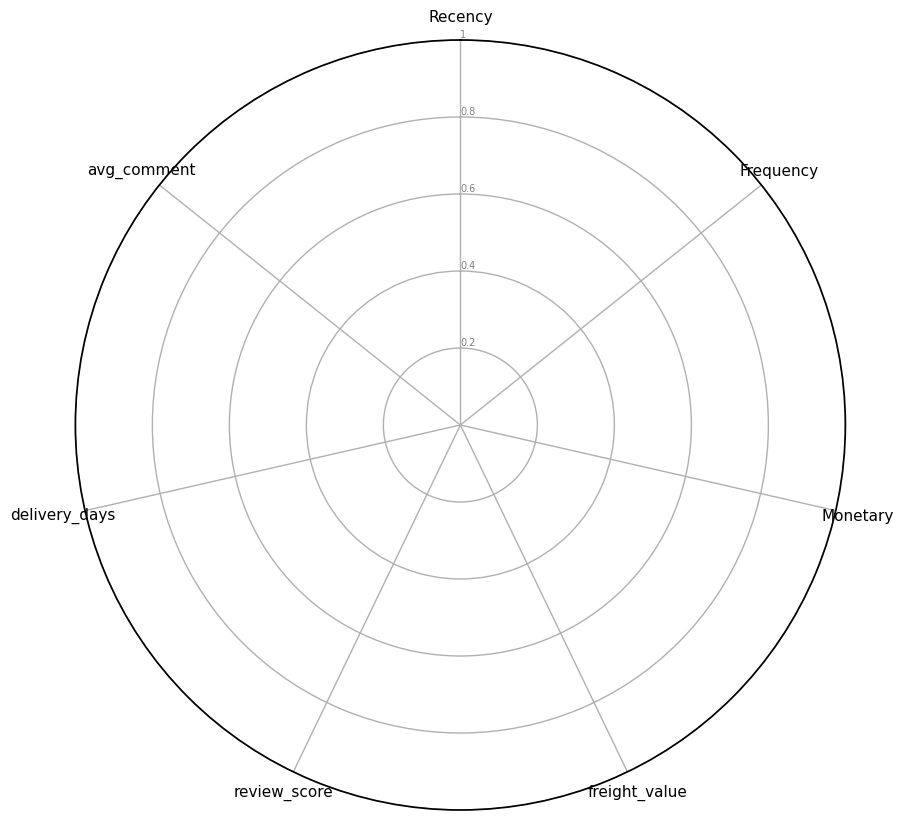

In [255]:
plot_rmf(clustered_brc_data, 'labels_brc')

   labels_brc  Recency  Frequency  Monetary  freight_value  review_score  \
0           0     0.30       0.01      0.35           0.02          0.23   
1           1     0.33       0.02      0.33           0.01          0.93   
2           2     0.45       0.02      0.35           0.01          0.85   
3           3     0.38       0.04      0.38           0.02          0.05   

   delivery_days  avg_comment  
0           0.45         0.16  
1           0.45         0.06  
2           0.45         0.66  
3           0.45         0.75  


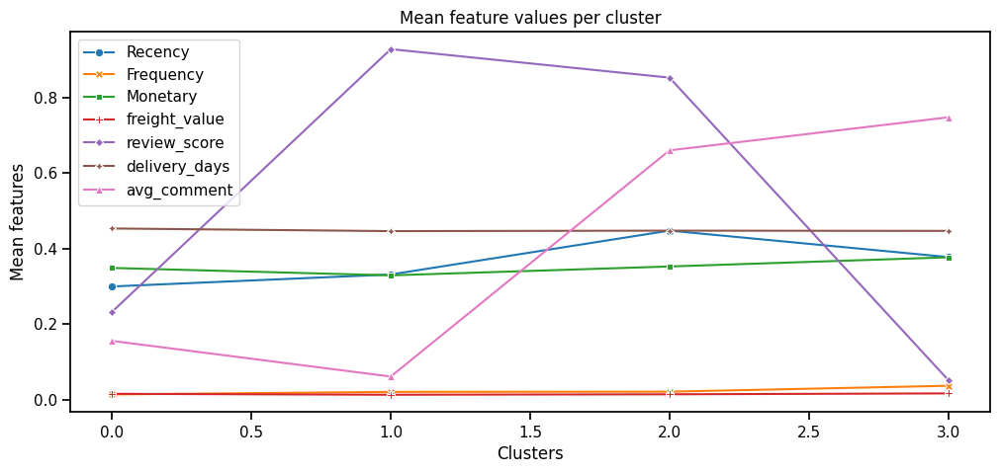

In [258]:
def plot_cluster_means(data, features, cluster_column='labels_brc', figsize=(12, 5)):
    group_data = data.groupby([cluster_column], as_index=False).agg(features)
    
    plt.figure(figsize=figsize)
    sns.lineplot(data=group_data.iloc[:, 1:], markers=True, dashes=False)
    plt.xlabel("Clusters")
    plt.ylabel("Mean features")
    plt.title("Mean feature values per cluster")

    display_data = group_data.round(2)
    print(display_data)
    return display_data

features_to_plot = {
    'Recency': 'mean',
    'Frequency': 'mean',
    'Monetary': 'mean',
    'freight_value': 'mean',
    'review_score': 'mean',
    'delivery_days': 'mean',
    'avg_comment': 'mean',
}

cluster_means_data_brc = plot_cluster_means(clustered_brc_data, features_to_plot)

In [259]:
plothist(clustered_brc, 'labels_brc')

NameError: name 'clustered_brc' is not defined

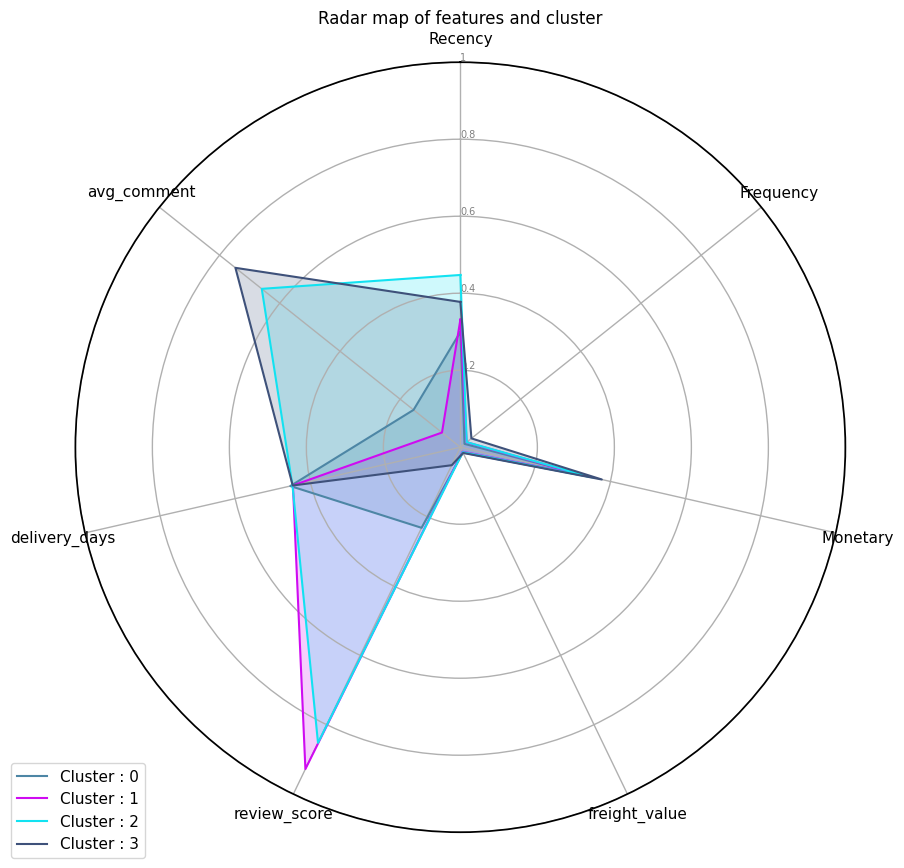

In [260]:
radar_plot(clustered_brc_data, 'labels_brc')

### Choosing model 

In [263]:
data_score_clustering.round(2)

,Model,Number_of_cluster,silhouette_score,calinski_harabasz_score,davies_bouldin_score
0,Kmeans,6,0.30,46534.63,1.12
1,Gaussian mixture,5,0.19,22710.96,2.93
2,Birch,4,0.39,36563.92,1.10
3,Gaussian mixture,5,0.19,22710.96,2.93


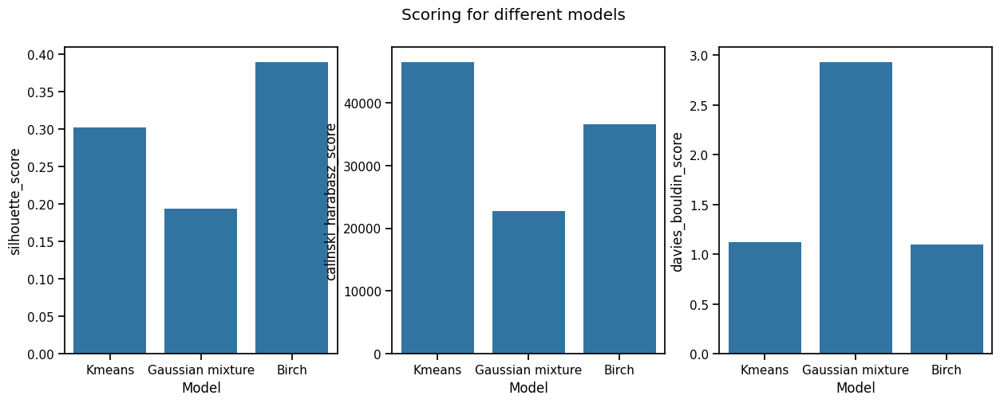

In [266]:
def plot_scores_comparison(data, score_columns, figsize=(15, 5)):
    fig, ax = plt.subplots(1, len(score_columns), figsize=figsize)

    for i, score_column in enumerate(score_columns):
        sns.barplot(x='Model', y=score_column, data=data, ax=ax[i])

    fig.suptitle("Scoring for different models")
    plt.show()

# Assuming data_score_clustering is your DataFrame
score_columns_to_plot = ['silhouette_score', 'calinski_harabasz_score', 'davies_bouldin_score']
plot_scores_comparison(data_score_clustering, score_columns_to_plot)

KMeans and Birch are better

## Tunning hyperparameters

#### Kmeans

In [267]:
def evaluate_hyperparameters(data, n_clusters, n_init_values, max_iter_multiplier):
    hyper_sil = []
    hyper_dav = []
    hyper_cal = []

    for n_init in n_init_values:
        max_iter = n_init * max_iter_multiplier
        cluster_km_c = KMeans(n_clusters=n_clusters, init='k-means++', n_init=n_init, max_iter=max_iter, random_state=42)
        labels = cluster_km_c.fit(data).labels_
        hyper_sil.append(silhouette_score(data, labels))
        hyper_dav.append(davies_bouldin_score(data, labels))
        hyper_cal.append(calinski_harabasz_score(data, labels))

    return hyper_sil, hyper_dav, hyper_cal

# Assuming data_cluster_scaled is your input data
n_clusters = 6
n_init_values = [10, 20, 30, 40]
max_iter_multiplier = 10

hyper_sil, hyper_dav, hyper_cal = evaluate_hyperparameters(data_cluster_scaled, n_clusters, n_init_values, max_iter_multiplier)

In [270]:
def create_scores_dataframe(hyper_sil, hyper_cal, hyper_dav):
    scores = pd.DataFrame({
        'silhouette_score': hyper_sil,
        'calinski_harabasz_score': hyper_cal,
        'davies_bouldin_score': hyper_dav
    })
    return scores

scores_dataframe = create_scores_dataframe(hyper_sil, hyper_cal, hyper_dav)

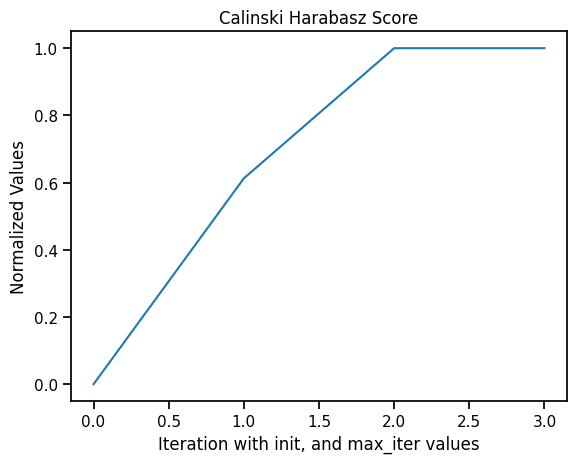

In [278]:
def normalize_and_plot(data, column, xlabel, ylabel, title):
    normalized_data = (data[column] - data[column].min()) / (data[column].max() - data[column].min())
    normalized_data.plot()
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

column_to_normalize = 'calinski_harabasz_score'
xlabel = "Iteration with init, and max_iter values"
ylabel = "Normalized Values"
title = "Calinski Harabasz Score"

normalize_and_plot(scores, column_to_normalize, xlabel, ylabel, title)

#### Birch

In [279]:
def evaluate_birch_hyperparameters(data, n_clusters, branching_factor, threshold_values):
    hyper_sil_brc = []
    hyper_dav_brc = []
    hyper_cal_brc = []

    for threshold in threshold_values:
        cluster_brc_c = Birch(branching_factor=branching_factor, n_clusters=n_clusters, threshold=threshold)
        labels_brc = cluster_brc_c.fit(data).labels_
        hyper_sil_brc.append(silhouette_score(data, labels_brc))
        hyper_dav_brc.append(davies_bouldin_score(data, labels_brc))
        hyper_cal_brc.append(calinski_harabasz_score(data, labels_brc))

    return hyper_sil_brc, hyper_dav_brc, hyper_cal_brc

# Assuming data_cluster_scaled is your input data
n_clusters_brc = 4
branching_factor_brc = 200
threshold_values_brc = [0.3, 0.35, 0.4, 0.45]

hyper_sil_brc, hyper_dav_brc, hyper_cal_brc = evaluate_birch_hyperparameters(data_cluster_scaled, n_clusters_brc, branching_factor_brc, threshold_values_brc)

In [ ]:

scores_brc = pd.DataFrame()
scores_brc['silhouette_score'] = hyper_sil_brc
scores_brc['calinski_harabasz_score'] = hyper_cal_brc
scores_brc['davies_bouldin_score'] = hyper_dav_brc
scores_brc

,silhouette_score,calinski_harabasz_score,davies_bouldin_score
0,0.419295,34124.874019,0.986884
1,0.390288,36563.922128,1.100222
2,0.406444,37400.977981,1.067881
3,0.316696,35941.293819,1.218974


Text(0.5, 1.0, 'Birch')

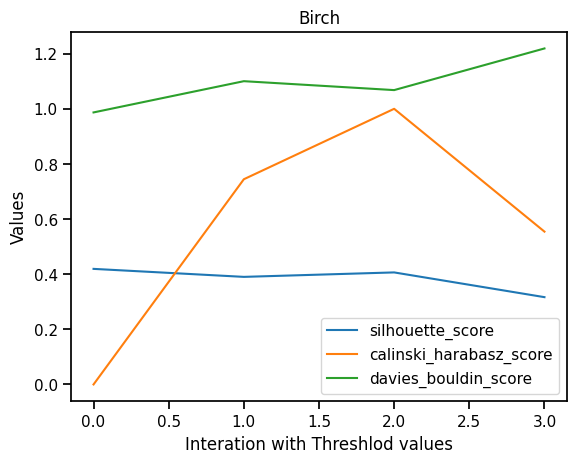

In [297]:
scores_brc['calinski_harabasz_score'] = (scores_brc['calinski_harabasz_score']-scores_brc['calinski_harabasz_score'].min())/(scores_brc['calinski_harabasz_score'].max()-scores_brc['calinski_harabasz_score'].min())
scores_brc.plot()
plt.xlabel("Interation with Threshlod values")
plt.ylabel("Values")
plt.title("Birch")

Birch with 4 clusters is the best choice.

## Interpretation

In [301]:
def cluster_and_label_data_birch(data, branching_factor, n_clusters, threshold):
    cluster_brc_result = Birch(branching_factor=branching_factor, n_clusters=n_clusters, threshold=threshold)
    
    clustered_data = data.copy()
    clustered_data['labels_brc_result'] = cluster_brc_result.fit(data).labels_
    
    return clustered_data

# Assuming data_cluster_scaled is your input data
branching_factor_brc = 100
n_clusters_brc = 4
threshold_brc = 0.4

clustered_brc_result = cluster_and_label_data_birch(data_cluster_scaled, branching_factor_brc, n_clusters_brc, threshold_brc)

In [305]:
data_conclusion = data_rfm[['customer_unique_id', 'Recency', 'Frequency', 'Monetary']].copy()
data_conclusion = data_conclusion.merge(data_train.groupby('customer_unique_id')['freight_value'].agg('sum'),how='left',on='customer_unique_id')
data_conclusion = data_conclusion.merge(data_train.groupby('customer_unique_id')['delivery_days'].agg('mean'),how='left',on='customer_unique_id')
data_conclusion = data_conclusion.merge(data_train.groupby('customer_unique_id')['review_score'].agg('mean'),how='left',on='customer_unique_id')
data_conclusion = data_conclusion.merge(data_train.groupby('customer_unique_id')['length_reviews_comment'].agg('mean'),how='left',on='customer_unique_id')
data_conclusion = data_conclusion.merge(data_train.groupby('customer_unique_id')['number_reviews'].agg('mean'),how='left',on='customer_unique_id')
data_conclusion['avg_comment'] = data_conclusion['length_reviews_comment']/data_conclusion['number_reviews']
data_conclusion.drop(['length_reviews_comment', 'number_reviews'], axis=1, inplace=True)
data_conclusion['labels'] = clustered_brc_result['labels_brc_result']
data_conclusion['state'] = data_train.groupby('customer_unique_id')['customer_state'].agg(lambda x: x.mode()).values

In [307]:
def calculate_cluster_means(data, cluster_column):
    group_result = data.groupby([cluster_column], as_index=False).agg({
        'Recency': 'mean',
        'Frequency': 'mean',
        'Monetary': 'mean',
        'freight_value': 'mean',
        'review_score': 'mean',
        'delivery_days': 'mean',
        'avg_comment': 'mean',
    })
    return group_result.round(2)

# Assuming data_conclusion is your DataFrame and 'labels' is the cluster column
cluster_means = calculate_cluster_means(data_conclusion, 'labels')

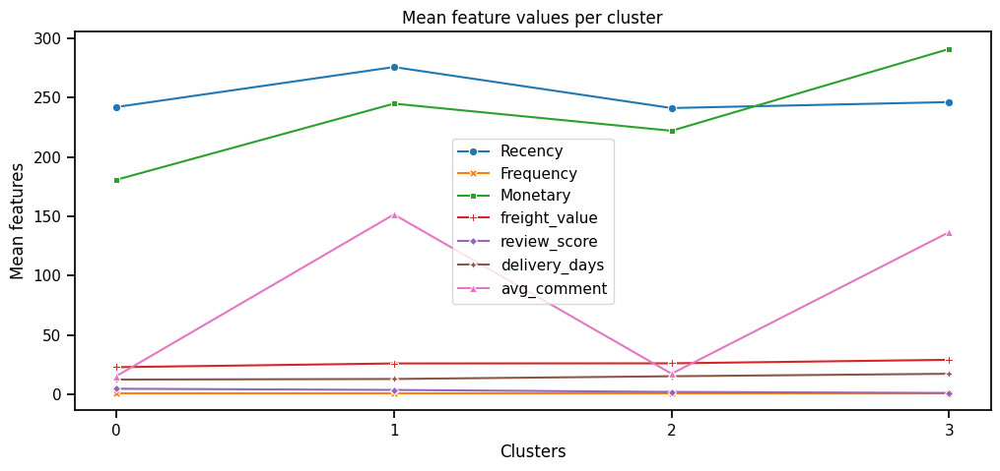

In [312]:
def plot_cluster_means(cluster_means, x_ticks):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=cluster_means.iloc[:, 1:], markers=True, dashes=False)
    plt.xlabel("Clusters")
    plt.ylabel("Mean features")
    plt.title("Mean feature values per cluster")
    plt.xticks(x_ticks)
    plt.show()

# Assuming cluster_means is your DataFrame and [0, 1, 2, 3] are the x_ticks
plot_cluster_means(cluster_means, [0, 1, 2, 3])

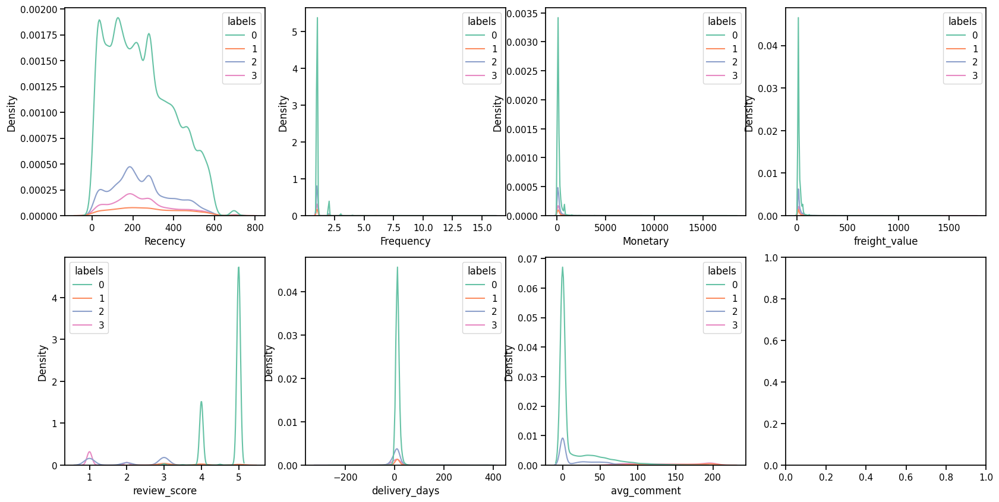

In [313]:
plothist(data_conclusion, 'labels')

In [316]:
def map_clusters_to_segments(labels):
    segment_mapping = {0: 'Valuable', 1: 'Passive', 2: 'Risky', 3: 'Loyal'}
    return [segment_mapping[label] for label in labels]

# Assuming segment_lst is your 'labels' column in data_conclusion
data_conclusion['segments'] = map_clusters_to_segments(data_conclusion['labels'])
data_conclusion

,customer_unique_id,Recency,Frequency,Monetary,freight_value,delivery_days,review_score,avg_comment,labels,state,segments
0,0000366f3b9a7992bf8c76cfdf3221e2,116,2,141.90,12.00,4.0,5.0,111.0,0,SP,Valuable
1,0000b849f77a49e4a4ce2b2a4ca5be3f,119,2,27.19,8.29,4.0,4.0,0.0,0,SP,Valuable
2,0000f46a3911fa3c0805444483337064,542,2,86.22,17.22,1.0,3.0,0.0,0,SC,Valuable
3,0000f6ccb0745a6a4b88665a16c9f078,326,1,43.62,17.63,11.0,4.0,12.0,0,PA,Valuable
4,0004aac84e0df4da2b147fca70cf8255,293,1,196.89,16.89,7.0,5.0,0.0,0,SP,Valuable
...,...,...,...,...,...,...,...,...,...,...,...
94715,fffcf5a5ff07b0908bd4e2dbc735a684,452,1,1531.82,121.22,26.0,5.0,0.0,0,PE,Valuable
94716,fffea47cd6d3cc0a88bd621562a9d061,267,1,84.58,19.69,2.0,4.0,0.0,0,BA,Valuable
94717,ffff371b4d645b6ecea244b27531430a,573,1,112.46,22.56,29.0,5.0,0.0,0,MT,Valuable
94718,ffff5962728ec6157033ef9805bacc48,124,1,133.69,18.69,13.0,5.0,133.0,0,ES,Valuable


## Conclusion

**Valuable**:
These customers fall within the average category but require attention. Strategies to engage them include creating brand awareness, offering free trials, launching limited-time offers, and enticing them with new product launches. Providing discounts and re-establishing a connection is crucial. Since delivery days and shipping values are high, consider offering discounts to address lower review scores.

**Passive**:
This segment represents below-average customers. To boost their engagement, create awareness of all products, persuade them to explore other categories, and offer discounts for payments through credit cards and the Boleto application. Providing free freight values, eliminating delivery charges, can also capture their interest. While their ratings are satisfactory, additional motivation is needed to drive purchases.

**Risky**:
Customers in this category made purchases long ago. To re-engage them, send personalized emails and messages, share special offers and useful resources. Implement a strategy to reactivate them, such as offering customer points that can be traded for vouchers. This approach aims to encourage more frequent and substantial purchases.

**Loyal**:
These customers make frequent purchases and spend more. Recognize and reward their loyalty by upselling and offering high-value items. Keep them informed about relevant events, encourage referrals, and actively seek feedback. Explore potential partnerships with brands to enhance their overall experience and loyalty.